<a href="https://colab.research.google.com/github/granatb/02456-deep-learning-with-PyTorch/blob/master/wind_power_EDA_Case3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# First chapter

In [ ]:
# from IPython.core.display import display, HTML
# display(HTML("<style>.container { width:70% !important; }</style>"))
# !pip install -U pandas-profiling

In [ ]:
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
sns.set_style("whitegrid")
%matplotlib inline

In [ ]:
def set_pandas_display_options() -> None:
    """Set pandas display options."""
    # Ref: https://stackoverflow.com/a/52432757/
    display = pd.options.display

    display.max_columns = 1000
    display.max_rows = 1000
    display.max_colwidth = 199
    display.width = 1000
    # display.precision = 2  # set as needed

set_pandas_display_options()

In [ ]:
def Lag_N(series, N):
    return series.shift(N)

def Lag_diff(series, N):
    return series.diff(periods = N)

def Lag_ratio(series, N):
    return series/series.shift(N)

def AVG_N(series, N):
    ret = [0]*len(series)
    for i in range(N,len(series)):
        ret[i] = np.mean(series[i-N:i])
    return ret

def Min_N(series, N):
    ret = [0]*len(series)
    for i in range(N, len(series)):
        ret[i] = np.min(series[i-N:i])
    return ret

def Max_N(series, N):
    ret = [0]*len(series)
    for i in range(N, len(series)):
        ret[i] = np.max(series[i-N:i])
    return ret

def Avg_shift(series, rng):
    ret = [0]*len(series)
    for i in range(rng[1], len(series)):
        ret[i] = np.mean(series[i-rng[1]:i-rng[0]+1])
    return ret
def SD_N(series, N):
    ret = [0] * len(series)
    for i in range(N, len(series)):
        ret[i] = np.std(series[i - N:i])
    return ret

def EMA_N(series, N):
    ret = pd.Series.ewm(series, span = N, adjust = False).mean()
    return ret

def MACD(series, args):
    ema_1 = pd.Series.ewm(series, span = args[0], adjust = False).mean()
    ema_2 = pd.Series.ewm(series, span = args[1], adjust = False).mean()
    ema_signal = pd.Series.ewm(series, span = args[2], adjust = False).mean()
    ret = ema_1-ema_2-ema_signal
    return ret

def SO_N(series, N):
    ret = [0] * len(series)
    for i in range(N, len(series)):
        L_N = np.min(series[i-N:i])
        H_N = np.max(series[i-N:i])
        ret[i] = 100*(series[i-1]-L_N)/(H_N-L_N)
    return ret
    
def RSI_N(series, N):
    delta = series.diff()
    up, down = delta.copy(), delta.copy()
    up[up < 0] = 0
    down[down > 0] = 0
    avg_gain = [0] * len(series)
    avg_loss = [0] * len(series)
    avg_gain[N+1] = pd.Series(up[1:N+1]).mean()
    avg_loss[N+1] = pd.Series(down[1:N+1]).mean()
    for i in range(N+2, len(series)):
        avg_gain[i] = ((N-1)*avg_gain[i-1]+up[i-1])/N
        avg_loss[i] = ((N-1) * avg_loss[i-1]+down[i-1]) / N

    RS = pd.Series(avg_gain) / ((-1) * pd.Series(avg_loss))
    RSI = 100.0 - (100.0 / (1.0 + RS))

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
datasets_path = "/content/drive/My Drive/data/Datasets/"

In [ ]:
park_info = pd.read_csv(datasets_path+'Case2/Park_Info.txt')
park_info

,Capacity: 99000KW（66*1500KW）


In [ ]:
turbine_info = pd.read_table(datasets_path+'Case2/Turbine_Info/Info.txt', sep = ":", header = None)
turbine_info

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: read_table is deprecated, use read_csv instead.
  """Entry point for launching an IPython kernel.


,0,1
0,Rated Power,1500KW
1,Hub Height,65m
2,Blade Length,38.5m


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: read_table is deprecated, use read_csv instead.
  """Entry point for launching an IPython kernel.


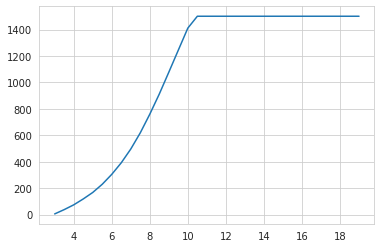

In [ ]:
power_curve = pd.read_table(datasets_path+'Case2/Turbine_Info/Power_Curve.txt', sep = " ")
plt.plot(power_curve)
plt.show()

In [ ]:
df = pd.read_csv(datasets_path+'Case2/Proj_NWP_Case2.csv')
df.Date_Time = pd.to_datetime(df.Date_Time)

In [ ]:
dfm = pd.read_csv(datasets_path+'Case2/Proj_Measurements_Case2.csv')
dfm.Date_Time = pd.to_datetime(dfm.Date_Time)

In [ ]:
df

,Date_Time,Direction_10m,Speed_10m,Temperature_10m,Pressure_seaLevel,Air Density_10m,Direction_50m,Speed_50m,Temperature_50m,Air Density_50m,Direction_100m,Speed_100m,Temperature_100m,Air Density_100m,Direction_150m,Speed_150m,Temperature_150m,Air Density_150m
0,2016-01-01 20:00:00,255,1.50,-5.90,996.90,1.300,246,1.00,-5.90,1.300,265,3.60,-5.90,1.300,268,6.20,-5.90,1.300
1,2016-01-01 20:15:00,261,1.59,-5.92,996.90,1.300,256,1.08,-5.92,1.300,268,3.82,-5.92,1.300,270,6.55,-5.92,1.300
2,2016-01-01 20:30:00,265,1.83,-5.96,996.90,1.300,263,1.30,-5.96,1.300,270,4.21,-5.96,1.300,272,7.09,-5.96,1.300
3,2016-01-01 20:45:00,269,2.20,-6.04,996.90,1.301,267,1.64,-6.04,1.301,272,4.74,-6.04,1.301,273,7.79,-6.04,1.301
4,2016-01-01 21:00:00,271,2.67,-6.14,996.90,1.301,270,2.06,-6.14,1.301,273,5.36,-6.14,1.301,274,8.61,-6.14,1.301
5,2016-01-01 21:15:00,272,3.19,-6.26,996.90,1.302,272,2.54,-6.26,1.302,274,6.06,-6.26,1.302,274,9.49,-6.26,1.302
6,2016-01-01 21:30:00,273,3.75,-6.40,996.90,1.303,274,3.05,-6.40,1.303,274,6.78,-6.40,1.303,275,10.40,-6.40,1.303
7,2016-01-01 21:45:00,274,4.31,-6.55,996.90,1.303,275,3.56,-6.55,1.303,275,7.49,-6.55,1.303,275,11.30,-6.55,1.303
8,2016-01-01 22:00:00,275,4.83,-6.71,996.90,1.304,276,4.04,-6.71,1.304,275,8.15,-6.71,1.304,275,12.15,-6.71,1.304
9,2016-01-01 22:15:00,275,5.30,-6.88,996.90,1.305,276,4.46,-6.88,1.305,275,8.73,-6.88,1.305,275,12.89,-6.88,1.305


In [ ]:
dfm

,Date_Time,Speed_10m,Direction_10m,Speed_30m,Direction_30m,Speed_65m,Direction_65m,Speed_70m,Direction_70m,Park Power [KW]
0,2016-01-01 00:00:00,0.000,180.0,1.433,180.0,2.367,180.0,2.867,180.0,1270.0
1,2016-01-01 00:15:00,0.233,329.6,1.667,282.1,2.700,253.4,3.033,278.0,1633.0
2,2016-01-01 00:30:00,0.033,288.0,1.400,283.0,2.367,250.0,2.833,278.0,1528.0
3,2016-01-01 00:45:00,1.267,356.1,1.833,320.7,2.033,304.5,2.433,295.5,770.0
4,2016-01-01 01:00:00,1.400,9.1,2.033,323.6,1.967,313.2,2.100,306.7,37.0
5,2016-01-01 01:15:00,0.400,30.0,1.433,326.0,1.333,317.0,1.700,310.0,0.0
6,2016-01-01 01:30:00,0.000,180.0,0.567,180.0,0.400,180.0,1.300,180.0,0.0
7,2016-01-01 01:45:00,0.033,159.0,0.033,247.0,1.133,220.0,1.833,220.0,0.0
8,2016-01-01 02:00:00,0.033,159.0,0.033,247.0,1.000,220.0,1.633,220.0,42.0
9,2016-01-01 02:15:00,0.000,180.0,0.067,180.0,0.367,180.0,1.067,180.0,44.0


In [ ]:
df.columns

Index(['Date_Time', 'Direction_10m', 'Speed_10m', 'Temperature_10m', 'Pressure_seaLevel', 'Air Density_10m', 'Direction_50m', 'Speed_50m', 'Temperature_50m', 'Air Density_50m', 'Direction_100m', 'Speed_100m', 'Temperature_100m', 'Air Density_100m', 'Direction_150m', 'Speed_150m', 'Temperature_150m', 'Air Density_150m'], dtype='object')

In [ ]:
dfm.columns

Index(['Date_Time', 'Speed_10m', 'Direction_10m', 'Speed_30m', 'Direction_30m', 'Speed_65m', 'Direction_65m', 'Speed_70m', 'Direction_70m', 'Park Power [KW]'], dtype='object')

In [ ]:
#!pip install pandas==0.24

In [ ]:
prof = ProfileReport(df)
profm = ProfileReport(dfm)

In [ ]:
prof

Number of variables,18
Number of observations,173695
Total Missing (%),0.0%
Total size in memory,23.9 MiB
Average record size in memory,144.0 B
Numeric,6
Categorical,0
Boolean,0
Date,1
Text (Unique),0
Rejected,11


In [ ]:
profm

Number of variables,10
Number of observations,174927
Total Missing (%),3.1%
Total size in memory,13.3 MiB
Average record size in memory,80.0 B
Numeric,7
Categorical,0
Boolean,0
Date,1
Text (Unique),0
Rejected,2


In [ ]:
# df_full = dfm.add_suffix('_m').join(df.add_suffix('_nwp'))
df_full = dfm.merge(df, on = "Date_Time", suffixes=('_m', '_nwp'))
df_full['Month'] = pd.DatetimeIndex(df_full.Date_Time).month
df_full['Year'] = pd.DatetimeIndex(df_full.Date_Time).year
df_full['Day'] = pd.DatetimeIndex(df_full.Date_Time).day
df_full.head(3)

,Date_Time,Speed_10m_m,Direction_10m_m,Speed_30m,Direction_30m,Speed_65m,Direction_65m,Speed_70m,Direction_70m,Park Power [KW],Direction_10m_nwp,Speed_10m_nwp,Temperature_10m,Pressure_seaLevel,Air Density_10m,Direction_50m,Speed_50m,Temperature_50m,Air Density_50m,Direction_100m,Speed_100m,Temperature_100m,Air Density_100m,Direction_150m,Speed_150m,Temperature_150m,Air Density_150m,Month,Year,Day
0,2016-01-01 20:00:00,0.000,180.0,0.133,180.0,1.700,180.0,2.133,180.0,794.0,255,1.50,-5.90,996.9,1.3,246,1.00,-5.90,1.3,265,3.60,-5.90,1.3,268,6.20,-5.90,1.3,1,2016,1
1,2016-01-01 20:15:00,1.767,191.9,3.233,280.1,3.967,260.8,4.300,278.6,4342.0,261,1.59,-5.92,996.9,1.3,256,1.08,-5.92,1.3,268,3.82,-5.92,1.3,270,6.55,-5.92,1.3,1,2016,1
2,2016-01-01 20:30:00,1.633,288.4,3.367,279.9,4.367,257.4,4.700,280.4,6498.0,265,1.83,-5.96,996.9,1.3,263,1.30,-5.96,1.3,270,4.21,-5.96,1.3,272,7.09,-5.96,1.3,1,2016,1


In [ ]:
cors = pd.DataFrame([df_full.corrwith(df_full["Park Power [KW]"]), df_full.corrwith(df_full["Park Power [KW]"], method='spearman')]).T.sort_values(by=0, ascending=False)
cors.columns = ['pearson','spearman']
cors

,pearson,spearman
Park Power [KW],1.000000,1.000000
Speed_65m,0.760806,0.835329
Speed_30m,0.754218,0.808829
Speed_100m,0.672768,0.719516
Speed_10m_nwp,0.665765,0.689528
Speed_10m_m,0.664375,0.670744
Speed_150m,0.640201,0.694393
Speed_50m,0.633219,0.635719
Speed_70m,0.622991,0.667573
Direction_10m_m,0.318823,0.312113


In [ ]:
params = {"ytick.color" : "b",
          "xtick.color" : "b",
          "axes.labelcolor" : "b",
          "axes.edgecolor" : "b"}
plt.rcParams.update(params)

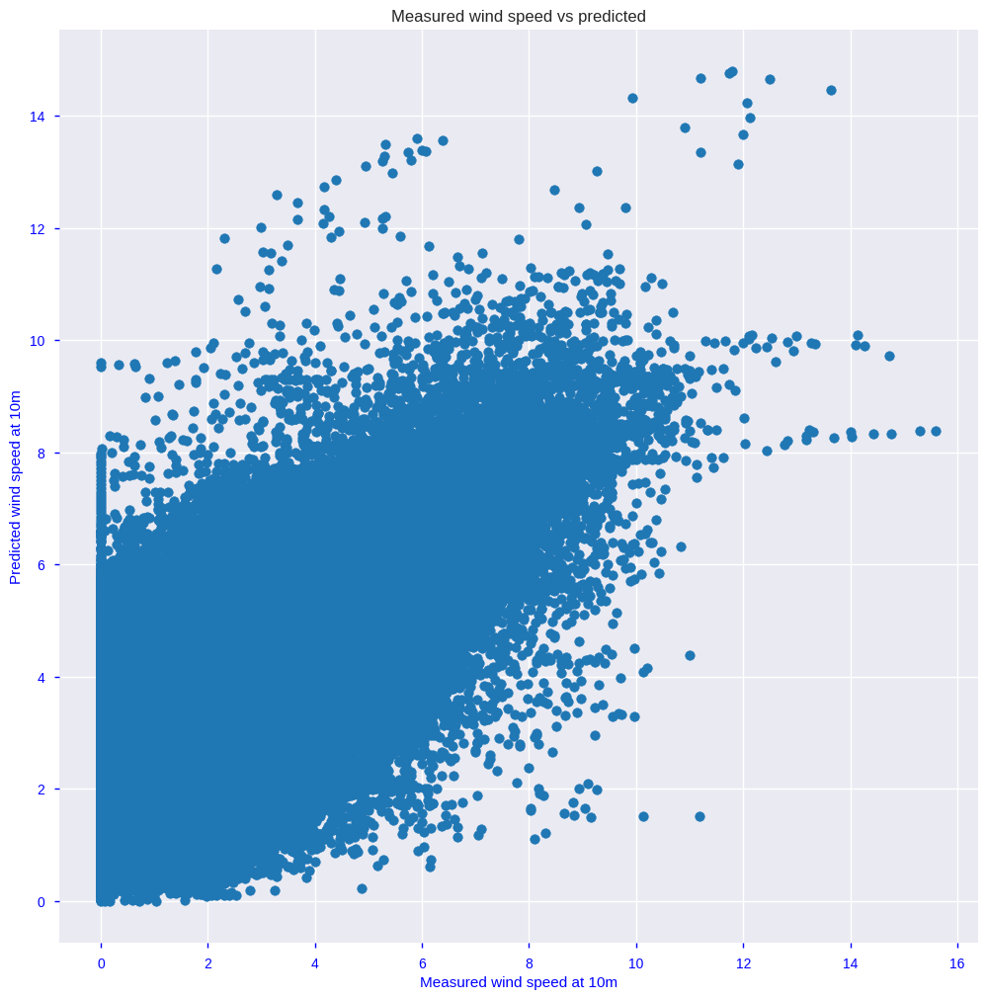

In [ ]:
plt.figure(figsize=(12,12))
plt.scatter(df_full.Speed_10m_m, df_full.Speed_10m_nwp)
plt.title('Measured wind speed vs predicted')
plt.xlabel('Measured wind speed at 10m')
plt.ylabel('Predicted wind speed at 10m')
plt.show()

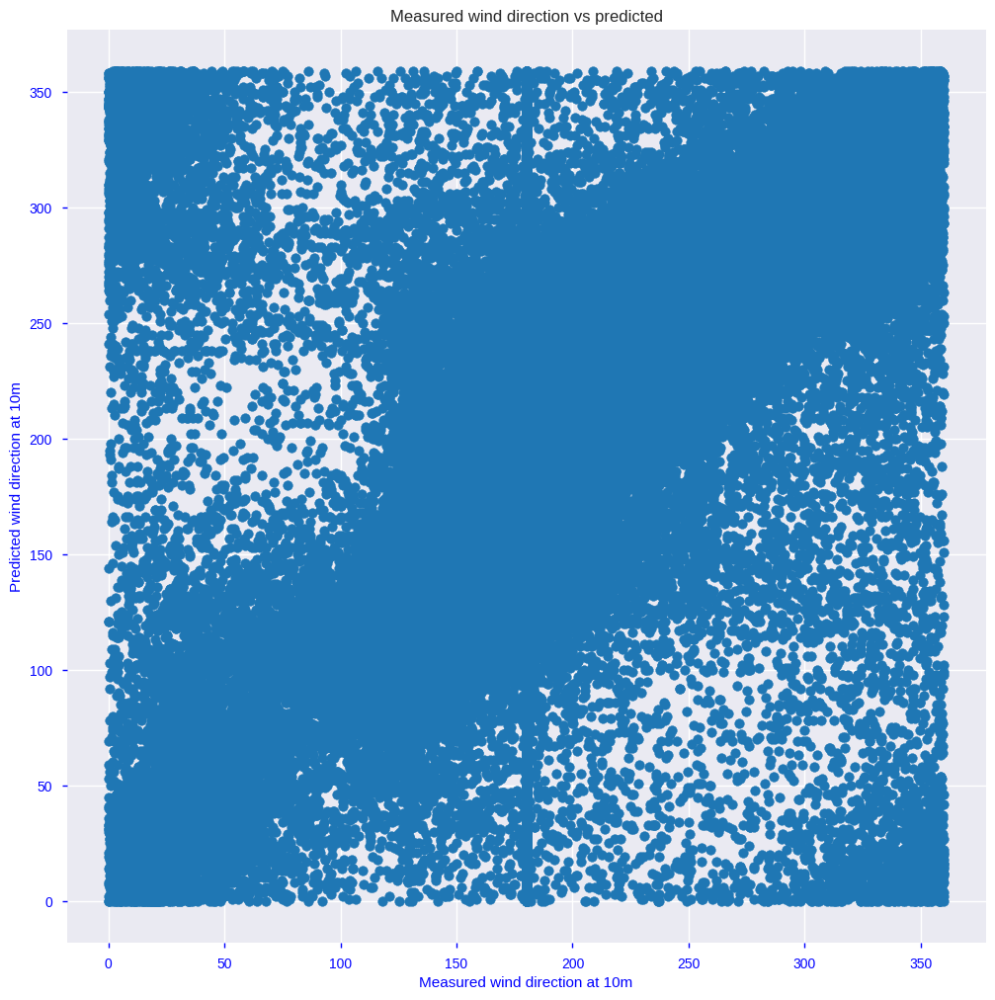

In [ ]:
plt.figure(figsize=(12,12))
plt.scatter(df_full.Direction_10m_m, df_full.Direction_10m_nwp)
plt.title('Measured wind direction vs predicted')
plt.xlabel('Measured wind direction at 10m')
plt.ylabel('Predicted wind direction at 10m')
plt.show()

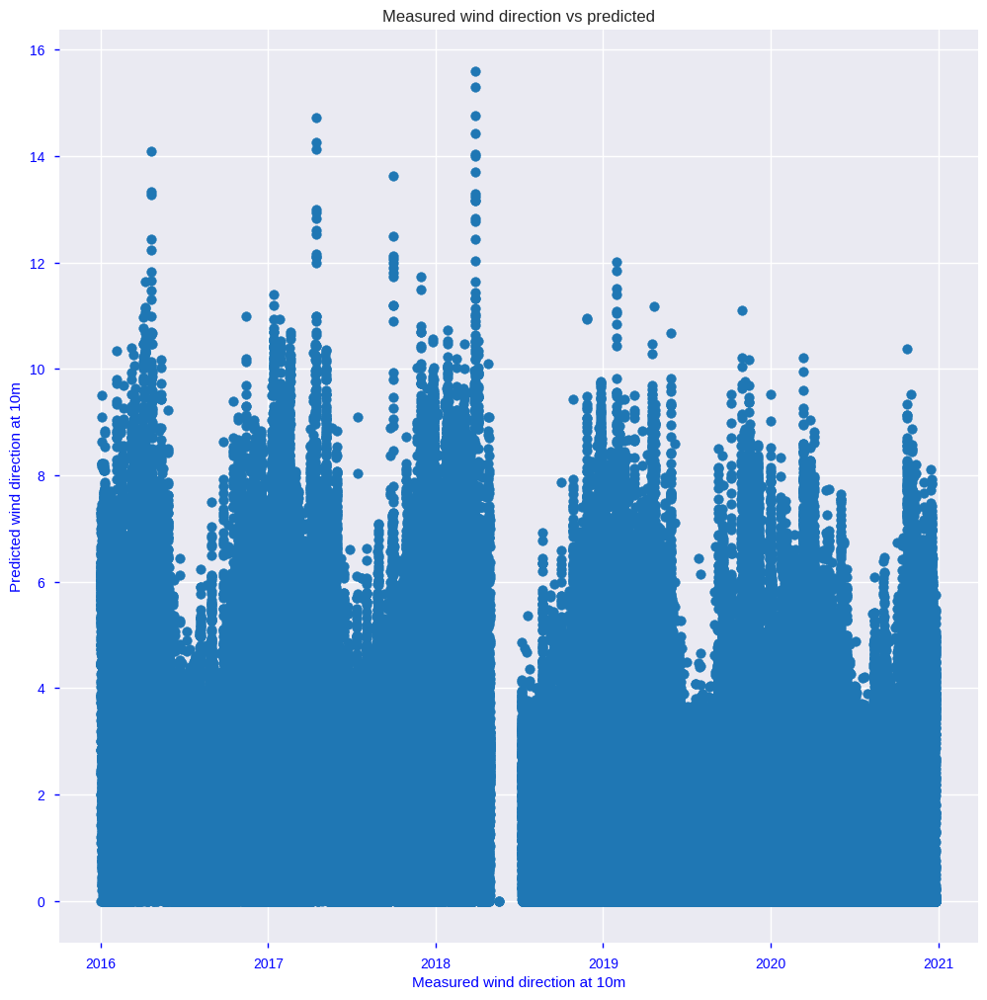

In [ ]:
plt.figure(figsize=(12,12))
plt.scatter(x=df_full.Date_Time, y=df_full.Speed_10m_m)
plt.title('Measured wind direction vs predicted')
plt.xlabel('Measured wind direction at 10m')
plt.ylabel('Predicted wind direction at 10m')
plt.show()

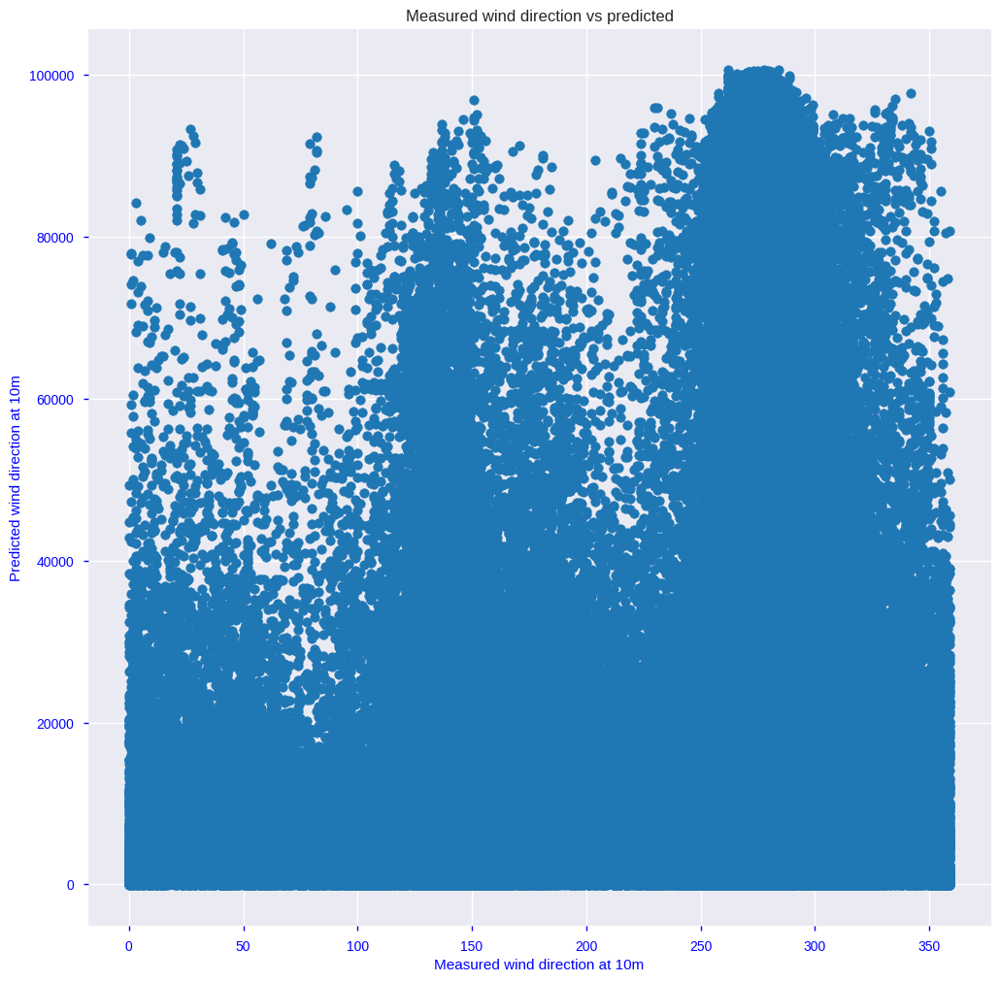

In [ ]:
plt.figure(figsize=(12,12))
plt.scatter(x=df_full.Direction_100m, y=df_full['Park Power [KW]'])
plt.title('Measured wind direction vs predicted')
plt.xlabel('Measured wind direction at 10m')
plt.ylabel('Predicted wind direction at 10m')
plt.show()

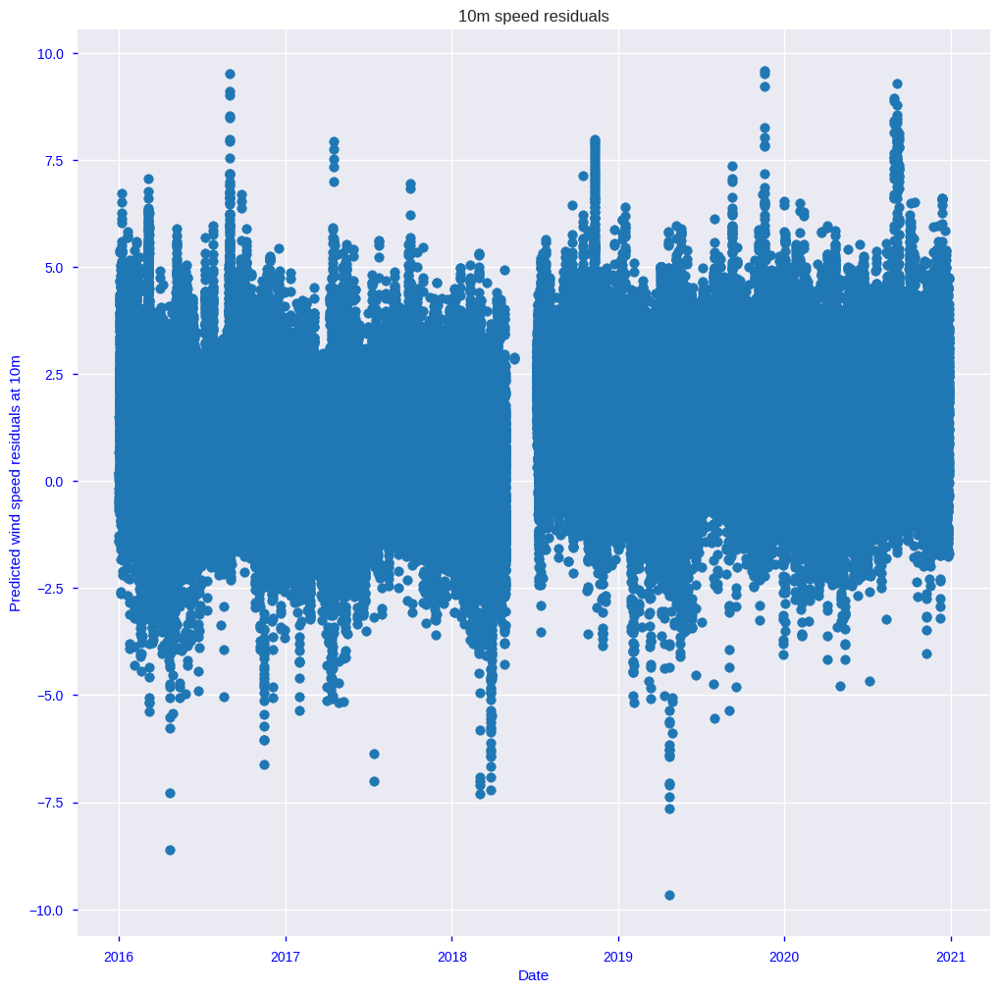

In [ ]:
plt.figure(figsize=(12,12))
plt.scatter(x=df_full.Date_Time, y=df_full.Speed_10m_nwp-df_full.Speed_10m_m)
plt.title('10m speed residuals')
plt.xlabel('Date')
plt.ylabel('Predicted wind speed residuals at 10m')
plt.show()

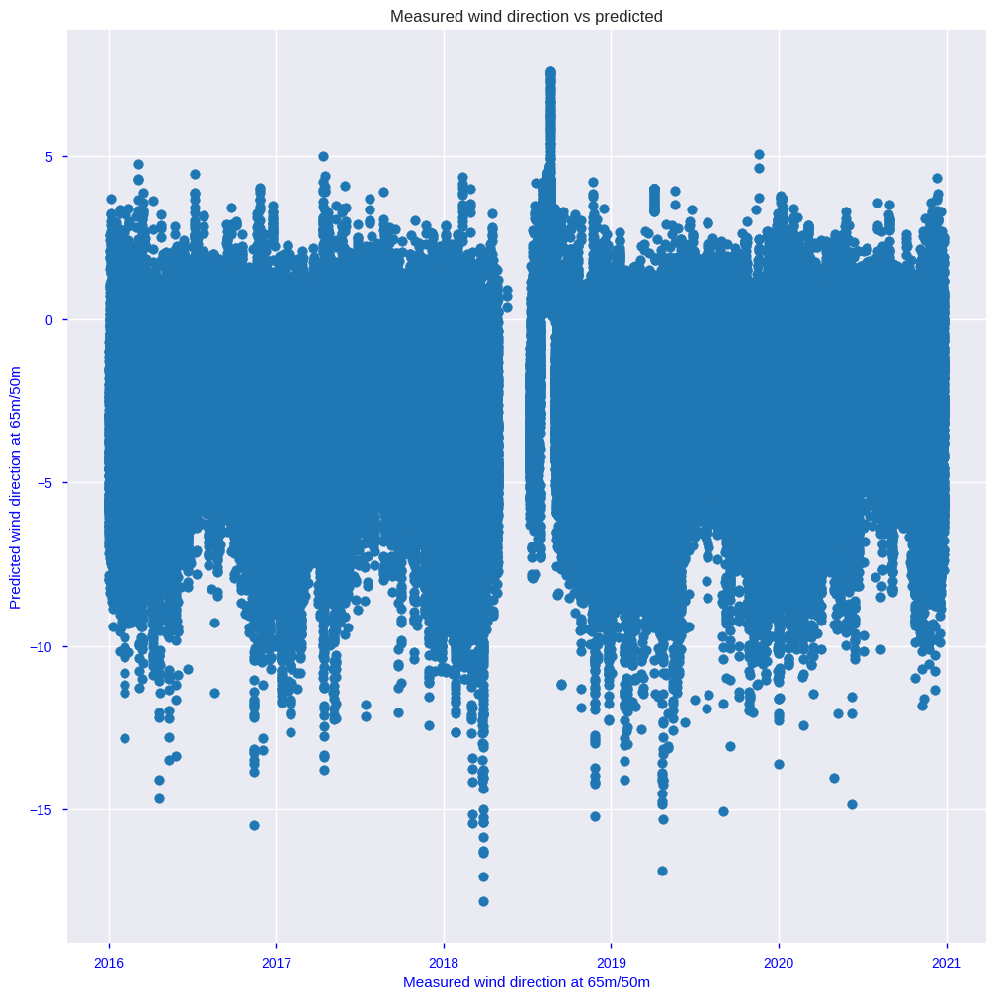

In [ ]:
plt.figure(figsize=(12,12))
plt.scatter(x=df_full.Date_Time, y=df_full.Speed_50m-df_full.Speed_65m)
plt.title('Measured wind direction vs predicted')
plt.xlabel('Measured wind direction at 65m/50m')
plt.ylabel('Predicted wind direction at 65m/50m')
plt.show()

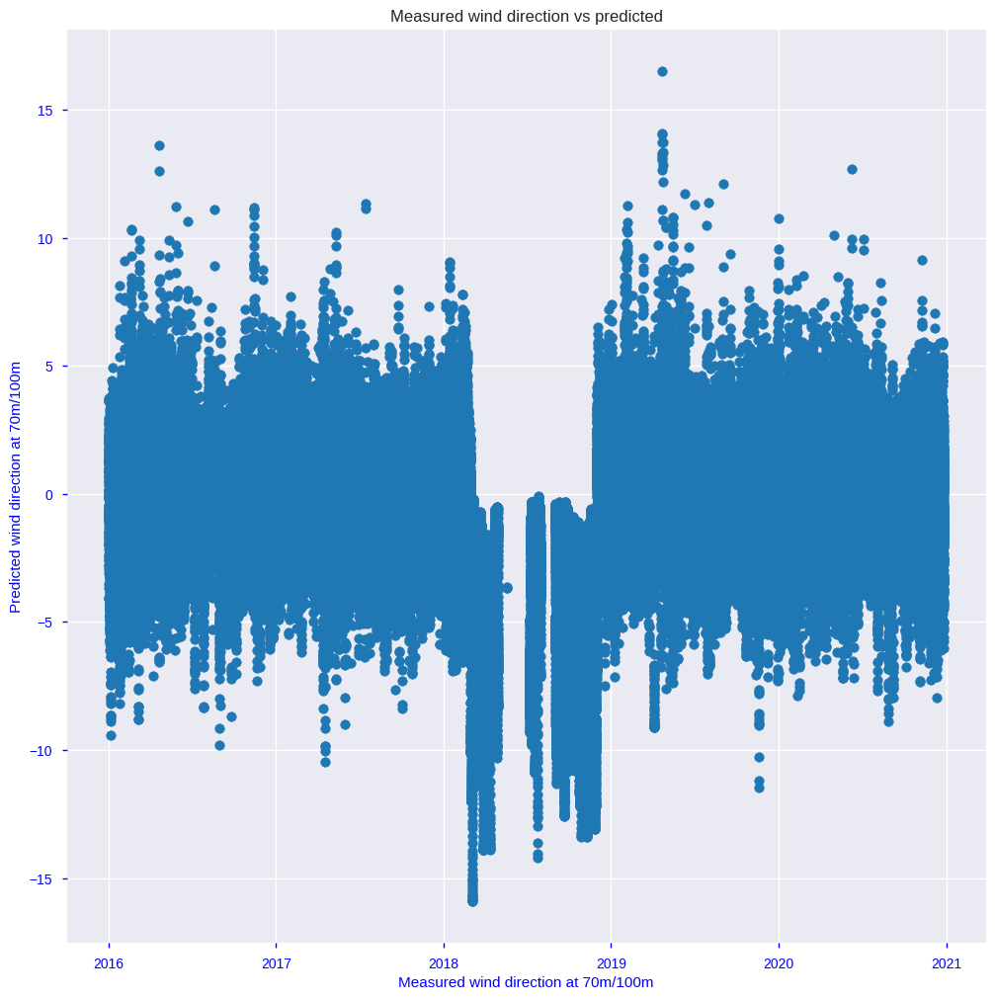

In [ ]:
plt.figure(figsize=(12,12))
plt.scatter(x=df_full.Date_Time, y=df_full.Speed_70m-df_full.Speed_100m)
plt.title('Measured wind direction vs predicted')
plt.xlabel('Measured wind direction at 70m/100m')
plt.ylabel('Predicted wind direction at 70m/100m')
plt.show()

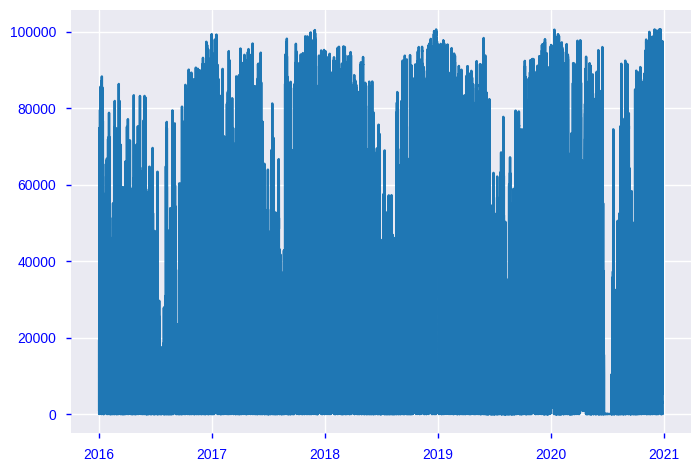

In [ ]:
plt.plot(df_full.Date_Time, df_full['Park Power [KW]'])

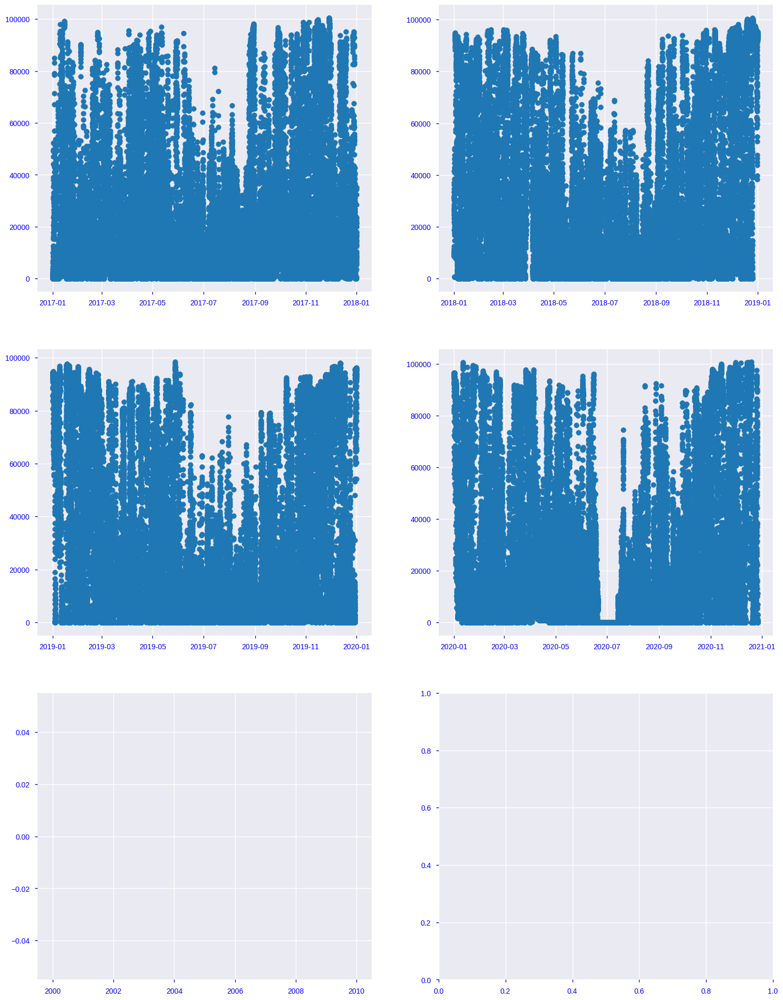

In [ ]:
years = ['2017', '2018', '2019', '2020', '2021']

_ , axs = plt.subplots(3, 2, figsize=(18, 24))
axs = axs.flatten()
i = 0
for yr, ax in zip(years, axs):
    plot_data = df_full[df_full.Date_Time.dt.strftime('%Y') == yr]
    ax.scatter(x=plot_data.Date_Time, y=plot_data['Park Power [KW]'])
    # ax.axis('off')
    # ax.title.set_text(species[i])
    i += 1
plt.show()

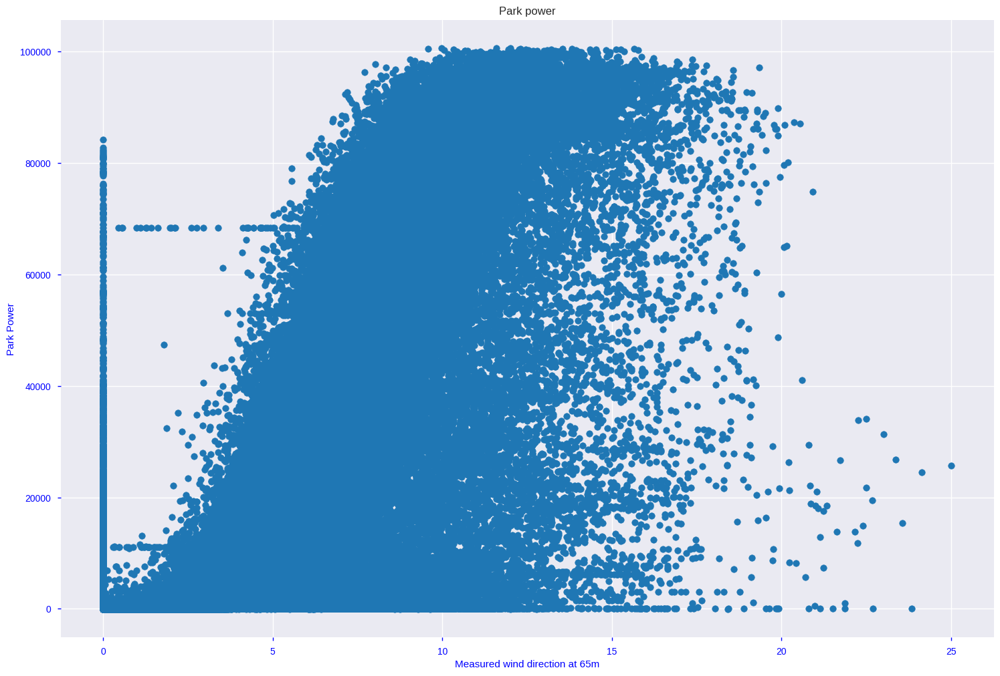

In [ ]:
plt.figure(figsize=(18,12))
plt.scatter(x=df_full.Speed_65m, y=df_full['Park Power [KW]'])
plt.title('Park power')
plt.xlabel('Measured wind direction at 65m')
plt.ylabel('Park Power')
plt.show()

In [ ]:
df_full.Speed_10m_m

0         0.000
1         1.767
2         1.633
3         2.467
4         2.000
5         3.000
6         4.133
7         4.800
8         4.667
9         5.200
10        5.467
11        6.367
12        5.967
13        6.667
14        6.600
15        7.367
16        7.300
17        7.167
18        6.367
19        6.100
20        5.700
21        6.033
22        4.900
23        3.733
24        3.867
25        4.433
26        5.167
27        5.367
28        6.033
29        6.033
30        5.500
31        5.800
32        6.000
33        5.900
34        6.100
35        5.900
36        6.233
37        5.867
38        6.333
39        6.200
40        6.533
41        6.167
42        6.300
43        6.500
44        6.167
45        6.200
46        5.333
47        5.567
48        5.567
49        5.567
50        6.167
51        6.533
52        6.267
53        6.267
54        6.067
55        5.600
56        5.733
57        6.033
58        6.367
59        7.000
60        6.933
61        7.300
62      

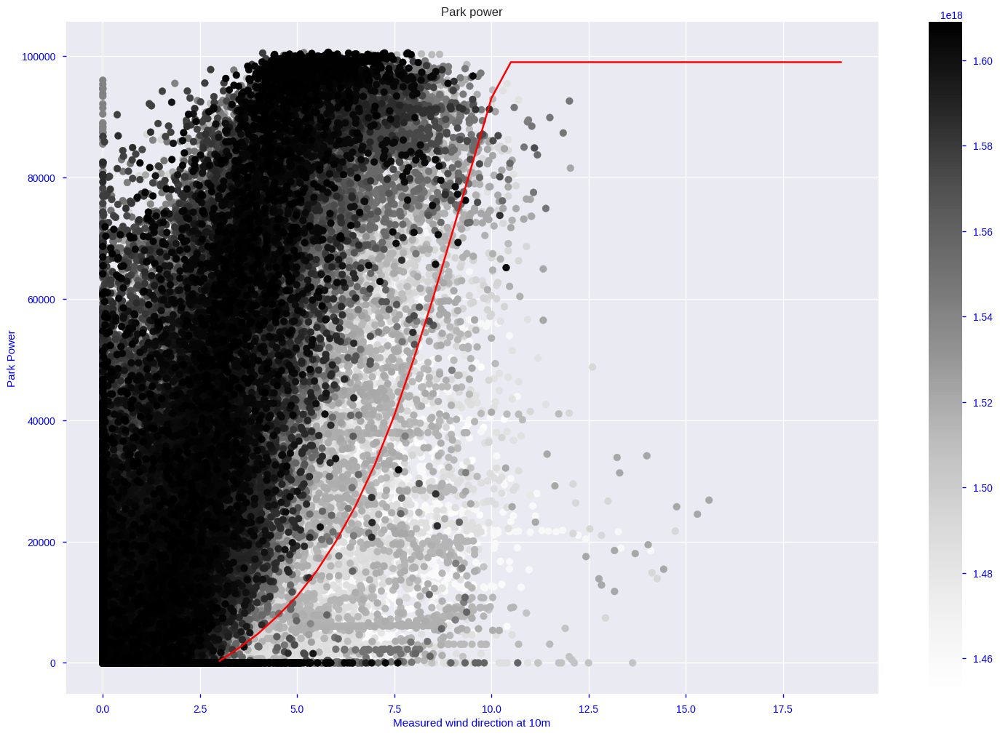

In [ ]:
plt.figure(figsize=(18,12))
plt.scatter(x=df_full.Speed_10m_m, y=df_full['Park Power [KW]'], c=df_full.Date_Time)
plt.colorbar()
plt.plot(power_curve*66, c='r')
plt.title('Park power')
plt.xlabel('Measured wind direction at 10m')
plt.ylabel('Park Power')
plt.show()

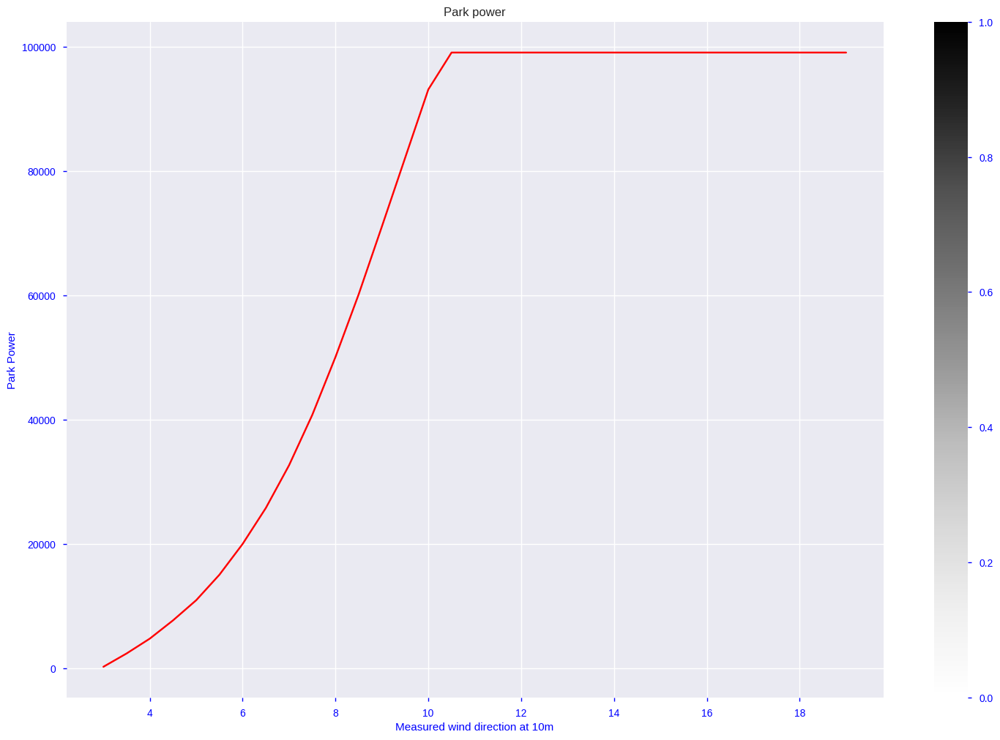

In [ ]:
plt.figure(figsize=(18,12))
plt.scatter(x=df_full[df_full.Date_Time>'2021-01'].Speed_10m_m, y=df_full[df_full.Date_Time>'2021-01']['Park Power [KW]'], c=df_full[df_full.Date_Time>'2021-01'].Date_Time)
plt.colorbar()
plt.plot(power_curve*66, c='r')
plt.title('Park power')
plt.xlabel('Measured wind direction at 10m')
plt.ylabel('Park Power')
plt.show()

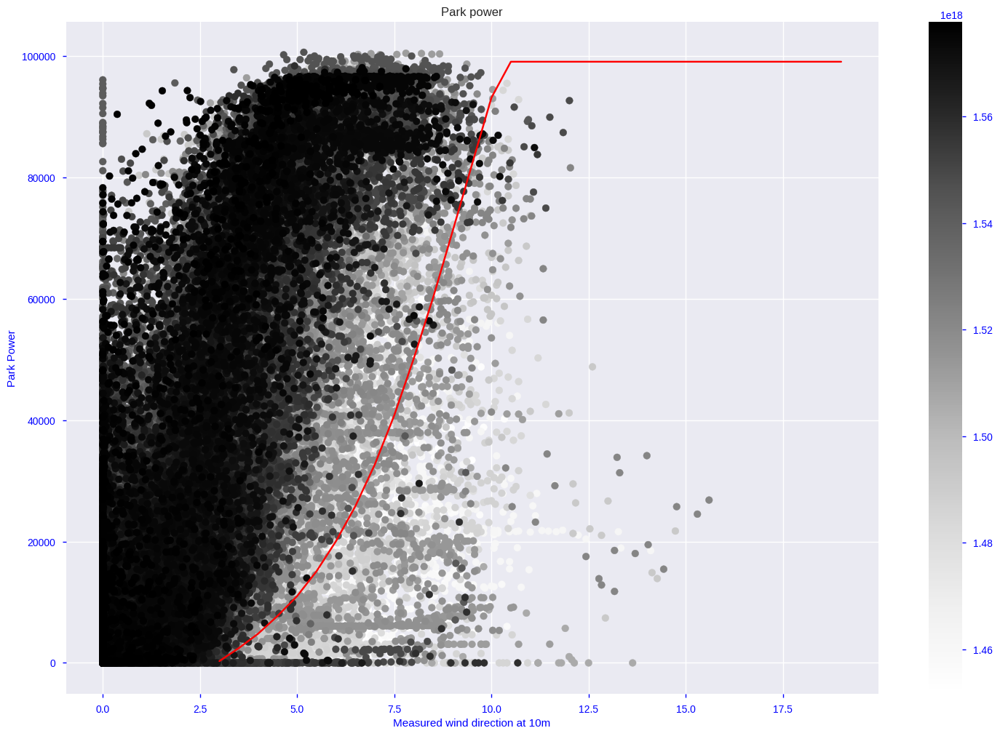

In [ ]:
plt.figure(figsize=(18,12))
plt.scatter(x=df_full[df_full.Date_Time<'2020'].Speed_10m_m, y=df_full[df_full.Date_Time<'2020']['Park Power [KW]'], c=df_full[df_full.Date_Time<'2020'].Date_Time)
plt.colorbar()
plt.plot(power_curve*66, c='r')
plt.title('Park power')
plt.xlabel('Measured wind direction at 10m')
plt.ylabel('Park Power')
plt.show()

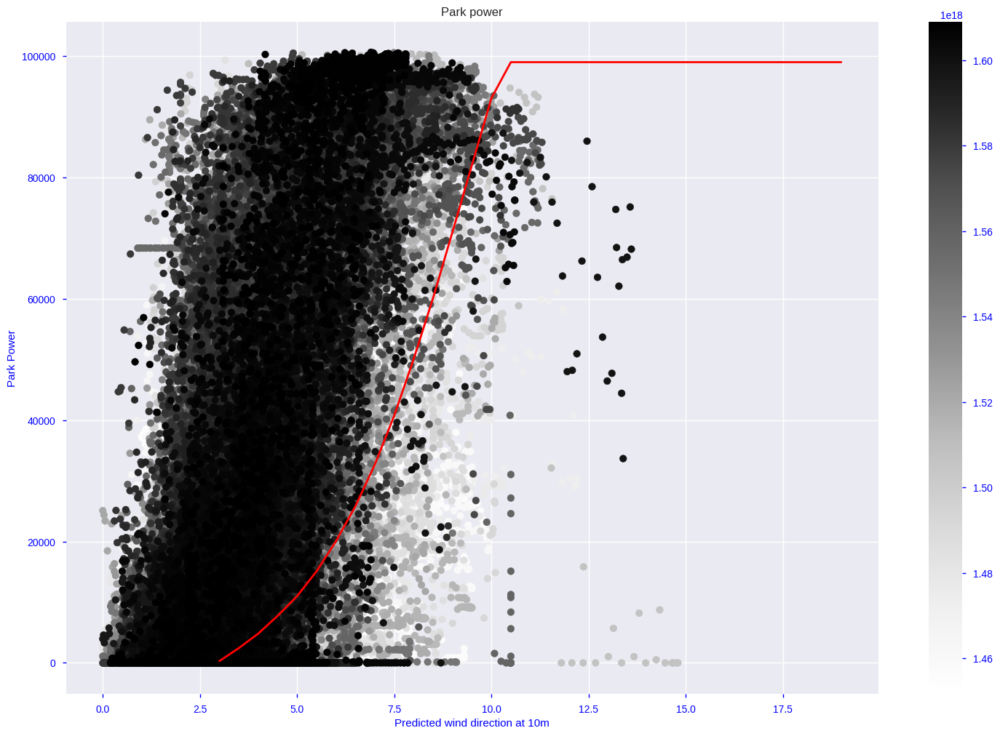

In [ ]:
plt.figure(figsize=(18,12))
plt.scatter(x=df_full.Speed_10m_nwp, y=df_full['Park Power [KW]'], c=df_full.Date_Time)
plt.colorbar()
plt.plot(power_curve*66, c='r', linewidth = 2)
plt.title('Park power')
plt.xlabel('Predicted wind direction at 10m')
plt.ylabel('Park Power')
plt.show()

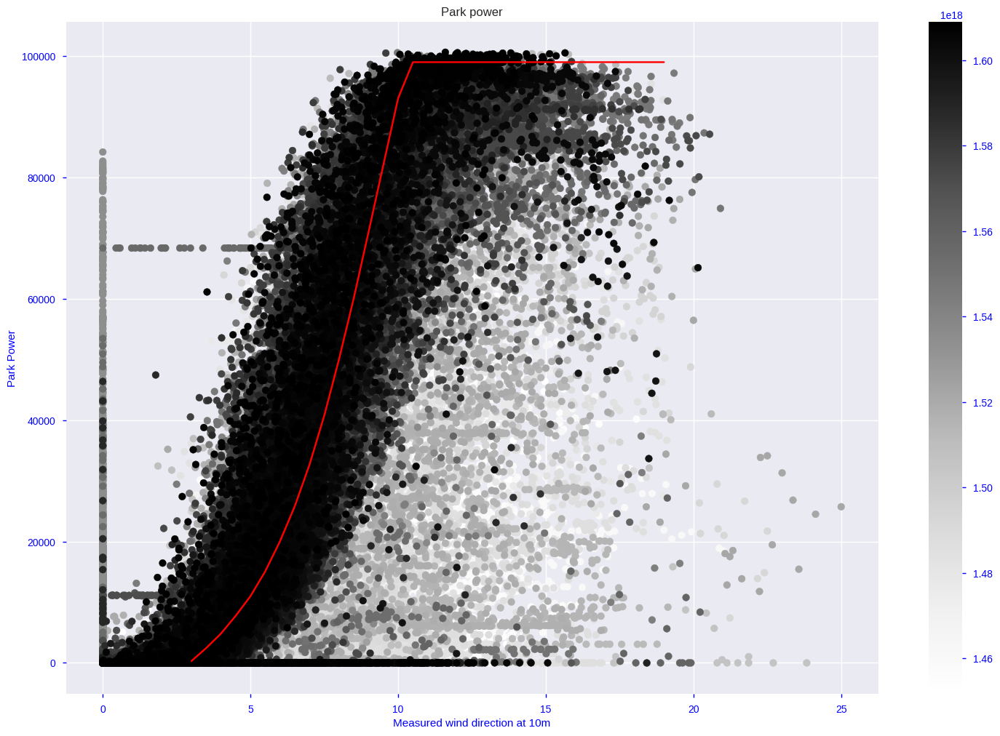

In [ ]:
plt.figure(figsize=(18,12))
plt.scatter(x=df_full.Speed_65m, y=df_full['Park Power [KW]'], c=df_full.Date_Time)
plt.colorbar()
plt.plot(power_curve*66, c='r')
plt.title('Park power')
plt.xlabel('Measured wind direction at 10m')
plt.ylabel('Park Power')
plt.show()

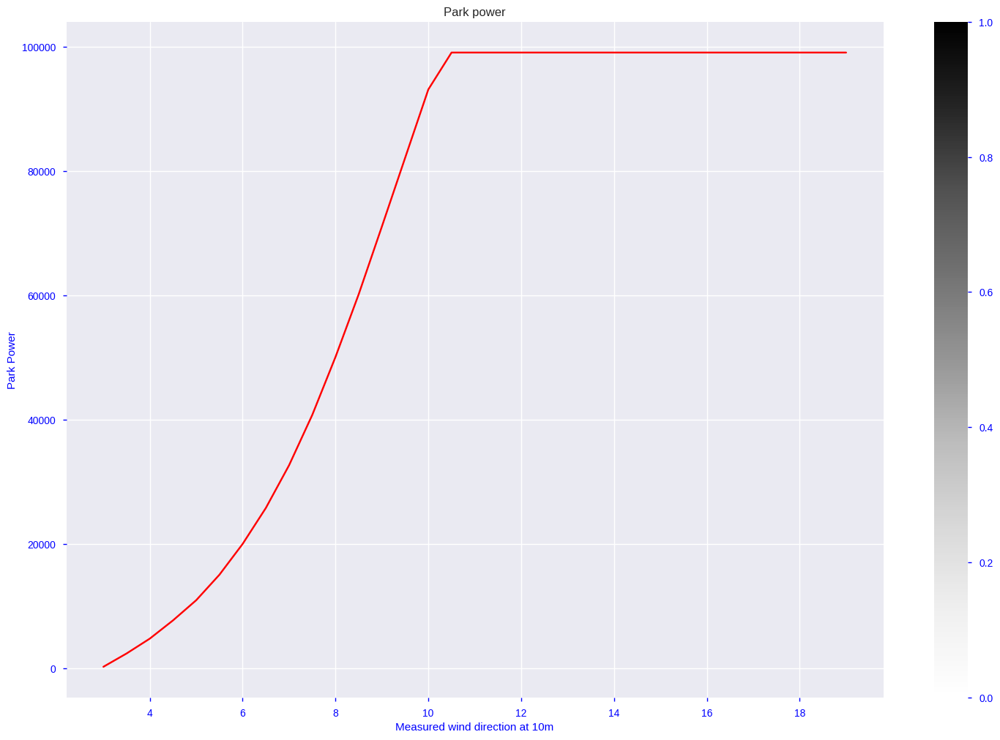

In [ ]:
plt.figure(figsize=(18,12))
plt.scatter(x=df_full[df_full.Date_Time>'2021-01'].Speed_65m, y=df_full[df_full.Date_Time>'2021-01']['Park Power [KW]'], c=df_full[df_full.Date_Time>'2021-01'].Date_Time)
plt.colorbar()
plt.plot(power_curve*66, c='r')
plt.title('Park power')
plt.xlabel('Measured wind direction at 10m')
plt.ylabel('Park Power')
plt.show()

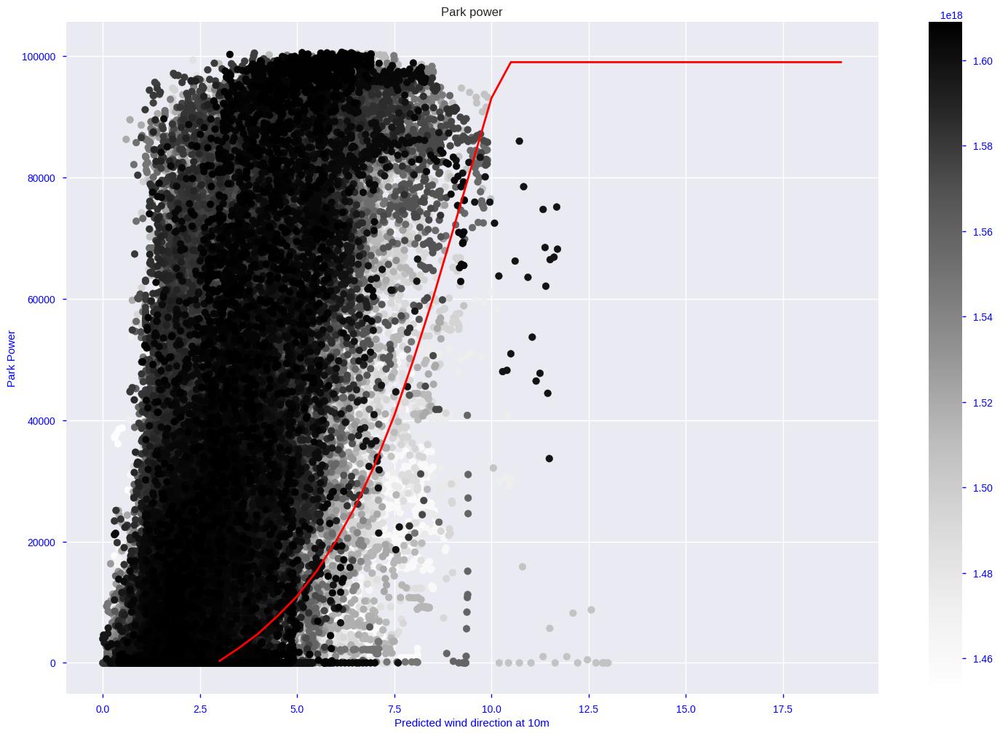

In [ ]:
plt.figure(figsize=(18,12))
plt.scatter(x=df_full.Speed_50m, y=df_full['Park Power [KW]'], c=df_full.Date_Time)
plt.colorbar()
plt.plot(power_curve*66, c='r', linewidth = 2)
plt.title('Park power')
plt.xlabel('Predicted wind direction at 10m')
plt.ylabel('Park Power')
plt.show()

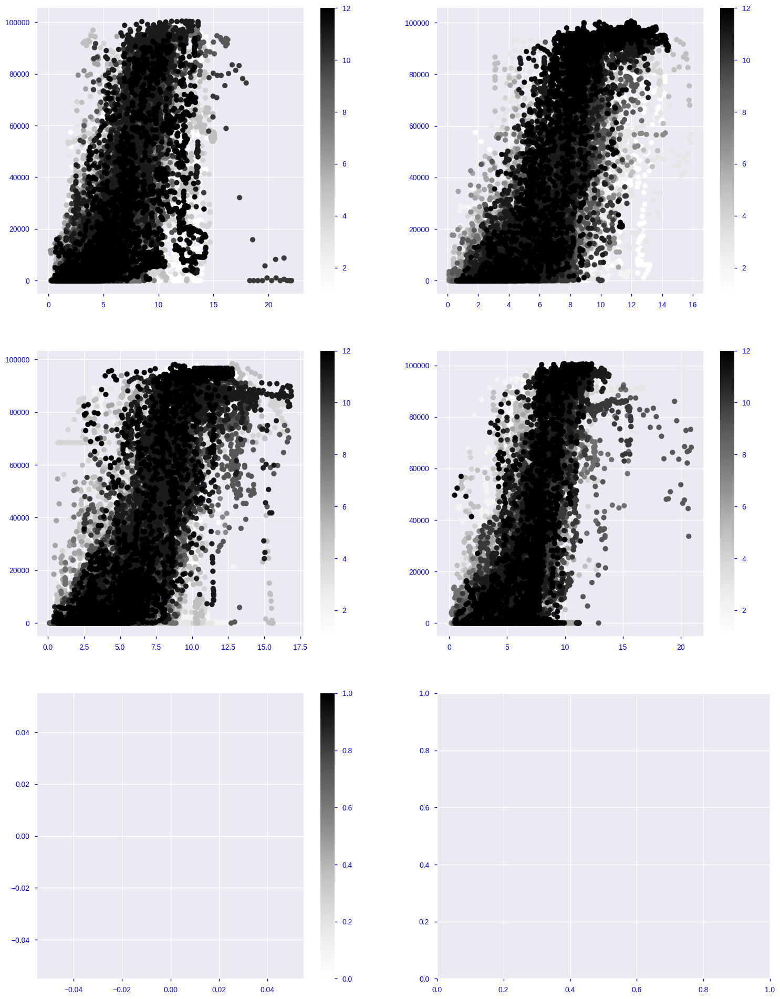

In [ ]:
years = ['2017', '2018', '2019', '2020', '2021']

fig , axs = plt.subplots(3, 2, figsize=(18, 24))
axs = axs.flatten()
i = 0
for yr, ax in zip(years, axs):
    plot_data = df_full[df_full.Date_Time.dt.strftime('%Y') == yr] 
    scat = ax.scatter(x=plot_data.Speed_100m, y=plot_data['Park Power [KW]'], c=plot_data.Month)
    fig.colorbar(scat, ax=ax)
    # ax.axis('off')
    # ax.title.set_text(species[i])
    i += 1

plt.show()

In [ ]:
df_full[(df_full.Date_Time.dt.strftime('%Y') == '2017') & (df_full.Month == 5)]

,Date_Time,Speed_10m_m,Direction_10m_m,Speed_30m,Direction_30m,Speed_65m,Direction_65m,Speed_70m,Direction_70m,Park Power [KW],Direction_10m_nwp,Speed_10m_nwp,Temperature_10m,Pressure_seaLevel,Air Density_10m,Direction_50m,Speed_50m,Temperature_50m,Air Density_50m,Direction_100m,Speed_100m,Temperature_100m,Air Density_100m,Direction_150m,Speed_150m,Temperature_150m,Air Density_150m,Month,Year,Day
46576,2017-05-01 00:00:00,0.867,313.0,3.233,299.0,6.333,297.5,6.767,306.2,51819.0,299,3.73,5.34,993.62,1.244,292,2.59,5.34,1.244,309,8.44,5.34,1.244,311,14.40,5.34,1.244,5,2017,1
46577,2017-05-01 00:15:00,1.333,313.0,3.433,299.0,6.867,297.3,7.233,305.8,56278.0,298,3.77,5.14,993.74,1.245,291,2.61,5.14,1.245,307,8.47,5.14,1.245,309,14.42,5.14,1.245,5,2017,1
46578,2017-05-01 00:30:00,0.867,318.1,3.633,296.6,7.733,296.6,7.700,302.7,53181.0,297,3.80,4.94,993.85,1.246,291,2.63,4.94,1.246,305,8.50,4.94,1.246,307,14.44,4.94,1.246,5,2017,1
46579,2017-05-01 00:45:00,1.000,318.8,3.633,293.8,8.133,293.2,7.500,299.4,57828.0,296,3.83,4.76,993.97,1.246,290,2.65,4.76,1.246,303,8.53,4.76,1.246,305,14.46,4.76,1.246,5,2017,1
46580,2017-05-01 01:00:00,0.967,316.2,3.833,291.2,7.833,290.0,8.033,298.6,64224.0,295,3.85,4.59,994.08,1.247,290,2.67,4.59,1.247,301,8.55,4.59,1.247,303,14.47,4.59,1.247,5,2017,1
46581,2017-05-01 01:15:00,0.833,308.3,3.567,291.1,7.967,289.4,9.100,296.9,69118.0,294,3.87,4.43,994.20,1.248,289,2.68,4.43,1.248,299,8.57,4.43,1.248,301,14.48,4.43,1.248,5,2017,1
46582,2017-05-01 01:30:00,0.667,300.0,3.567,290.8,8.000,282.6,8.867,297.2,74354.0,293,3.89,4.29,994.33,1.249,289,2.69,4.29,1.249,298,8.59,4.29,1.249,299,14.49,4.29,1.249,5,2017,1
46583,2017-05-01 01:45:00,1.200,321.3,3.633,294.3,7.467,276.7,8.400,296.0,75878.0,292,3.90,4.18,994.46,1.249,289,2.70,4.18,1.249,296,8.60,4.18,1.249,298,14.50,4.18,1.249,5,2017,1
46584,2017-05-01 02:00:00,1.900,316.2,4.000,291.1,7.733,273.3,8.500,296.0,73766.0,291,3.90,4.10,994.60,1.250,288,2.70,4.10,1.250,295,8.60,4.10,1.250,296,14.50,4.10,1.250,5,2017,1
46585,2017-05-01 02:15:00,1.833,319.4,4.067,291.1,7.467,273.2,8.167,297.2,66774.0,291,3.89,4.03,994.75,1.251,288,2.69,4.03,1.251,295,8.59,4.03,1.251,296,14.48,4.03,1.251,5,2017,1


In [ ]:
import itertools

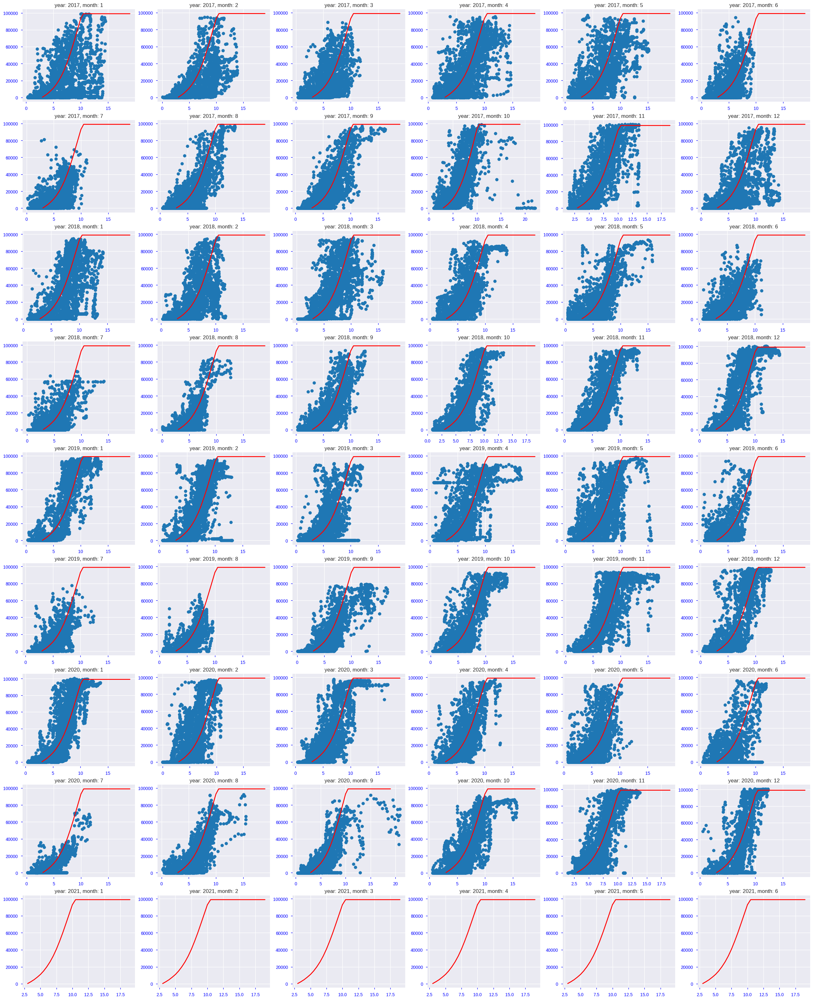

In [ ]:
years = ['2017', '2018', '2019', '2020', '2021']

fig , axs = plt.subplots(9, 6, figsize=(32, 40))
axs = axs.flatten()
i = 0
for yr, ax in zip(list(itertools.product(years, range(1,13))), axs):
    plot_data = df_full[(df_full.Date_Time.dt.strftime('%Y') == yr[0]) & (df_full.Month == yr[1])] 
    scat = ax.scatter(x=plot_data.Speed_100m, y=plot_data['Park Power [KW]'])
    ax.plot(power_curve*66, c='r', linewidth = 2)
    # ax.axis('off')
    ax.title.set_text(f'year: {yr[0]}, month: {yr[1]}')
    i += 1

plt.show()

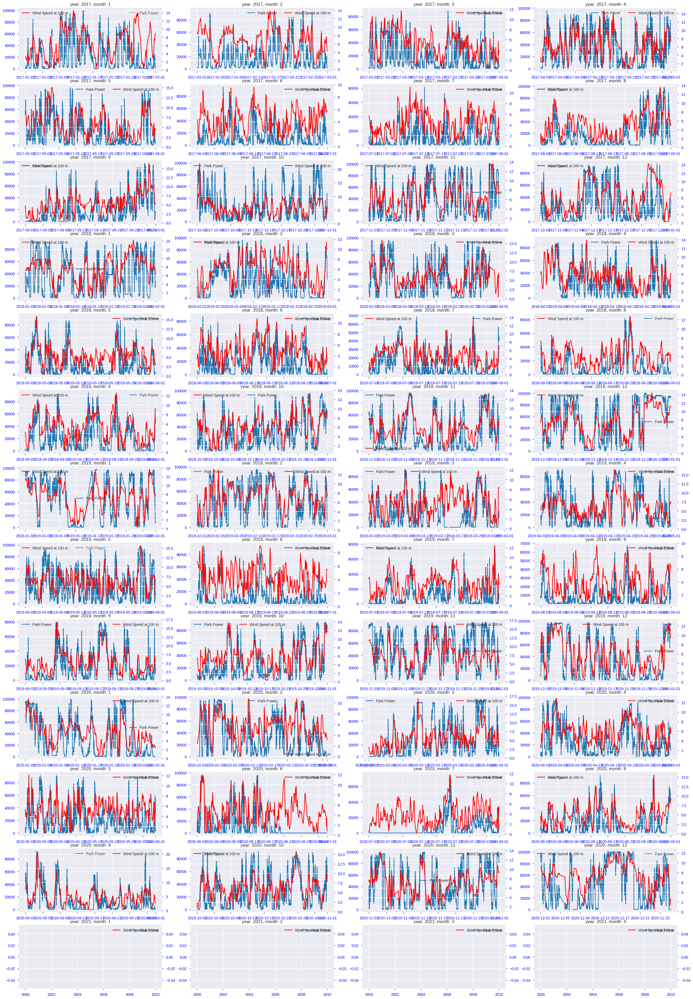

In [ ]:
years = ['2017', '2018', '2019', '2020', '2021']

fig , axs = plt.subplots(13, 4, figsize=(32, 48))
axs = axs.flatten()
i = 0
for yr, ax in zip(list(itertools.product(years, range(1,13))), axs):
    plot_data = df_full[(df_full.Date_Time.dt.strftime('%Y') == yr[0]) & (df_full.Month == yr[1])] 
    ax.plot(plot_data.Date_Time, plot_data['Park Power [KW]'], label='Park Power')
    ax.legend()
    ax2 = ax.twinx()
    ax2.plot(plot_data.Date_Time, plot_data.Speed_100m, c='r', label='Wind Speed at 100 m')
    # ax.axis('off')
    ax2.legend()
    ax.title.set_text(f'year: {yr[0]}, month: {yr[1]}')
    i += 1

plt.show()

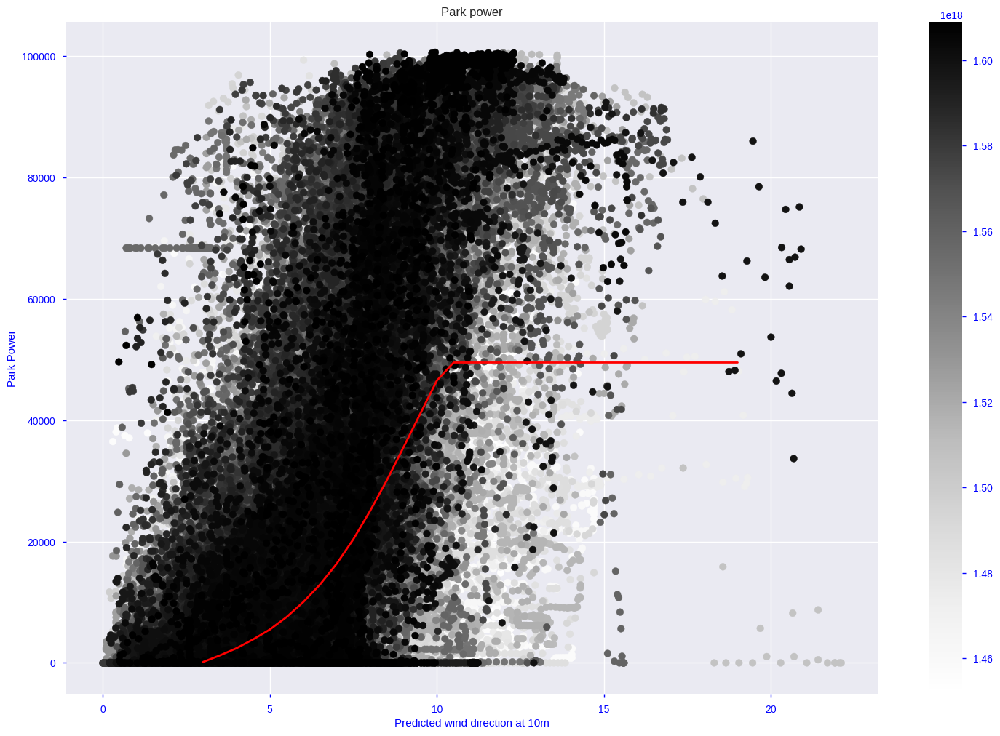

In [ ]:
plt.figure(figsize=(18,12))
plt.scatter(x=df_full.Speed_100m, y=df_full['Park Power [KW]'], c=df_full.Date_Time)
plt.colorbar()
plt.plot(power_curve*33, c='r', linewidth = 2)
plt.title('Park power')
plt.xlabel('Predicted wind direction at 10m')
plt.ylabel('Park Power')
plt.show()

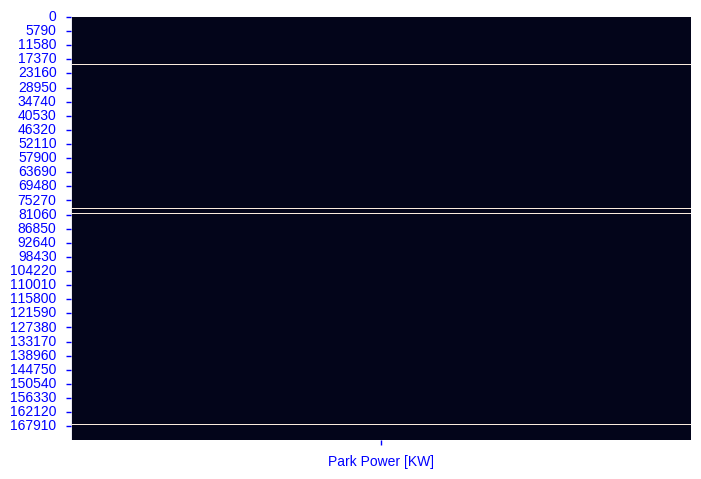

In [ ]:
sns.heatmap(df_full[['Park Power [KW]']].isnull(), cbar=False)              

# TO-DO

- residual time series plots
- modelling on weather predictions only
- cleaning the data
- choosing the right columns
- wind direction as degrees

# Modelling data

In [ ]:
target_variable = ['Park Power [KW]']
model_cols = ['Date_Time', 'Month', 'Year', 'Speed_100m', 'Direction_100m','Air Density_100m']
df_model = df_full[target_variable+model_cols]

In [ ]:
df_model.head()

,Park Power [KW],Date_Time,Month,Year,Speed_100m,Direction_100m,Air Density_100m
0,NaN,2017-01-07 20:15:00,1,2017,1.04,174,1.367
1,NaN,2017-01-07 20:30:00,1,2017,1.15,170,1.368
2,NaN,2017-01-07 20:45:00,1,2017,1.31,166,1.369
3,NaN,2017-01-07 21:00:00,1,2017,1.53,165,1.371
4,NaN,2017-01-07 21:15:00,1,2017,1.77,164,1.372


In [ ]:
df_model.shape

(145957, 7)

In [ ]:
df_model.dropna(inplace=True)
df_model.shape

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


(141144, 7)

In [ ]:
df_model = df_model[~(df_model['Park Power [KW]'] < 0)]
df_model.shape

(136764, 7)

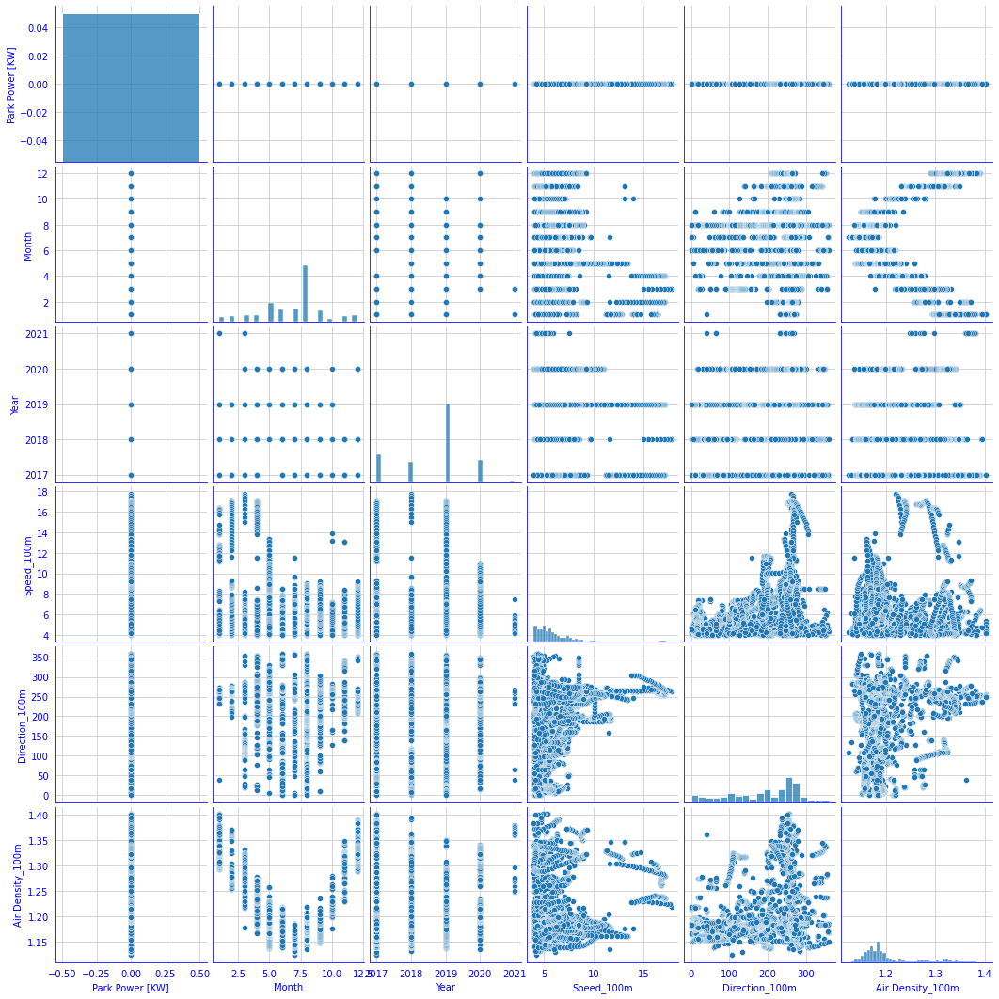

In [ ]:
sns.pairplot(df_model[(df_model.Speed_100m > 4) & (df_model['Park Power [KW]'] == 0)])

In [ ]:
df_model = df_model[~((df_model.Speed_100m > 4) & (df_model['Park Power [KW]'] == 0))]
df_model.shape

(133556, 7)

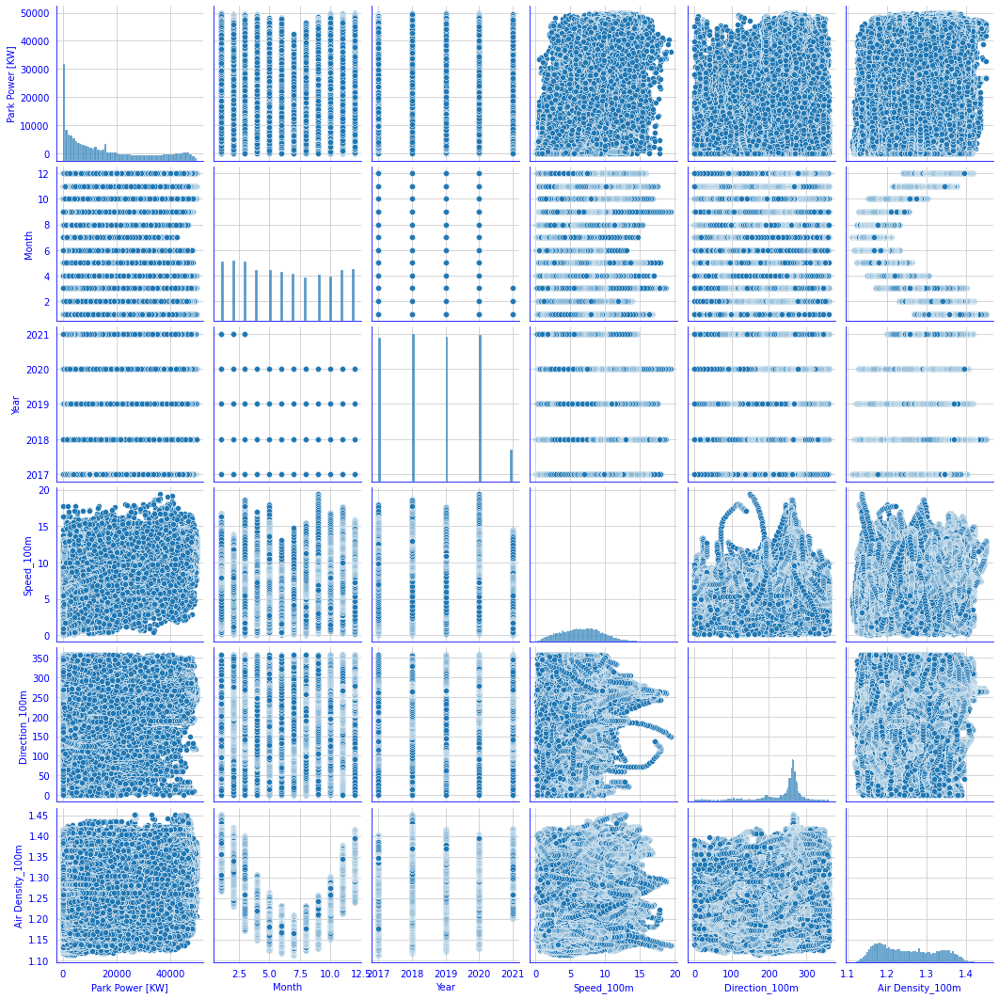

In [ ]:
sns.pairplot(df_model)

In [ ]:
df_model['Power_SD_12'] = SD_N(df_model['Park Power [KW]'], 12)
df_model = df_model[~(df_model['Power_SD_12'] == 0)]
df_model.shape

(126822, 8)

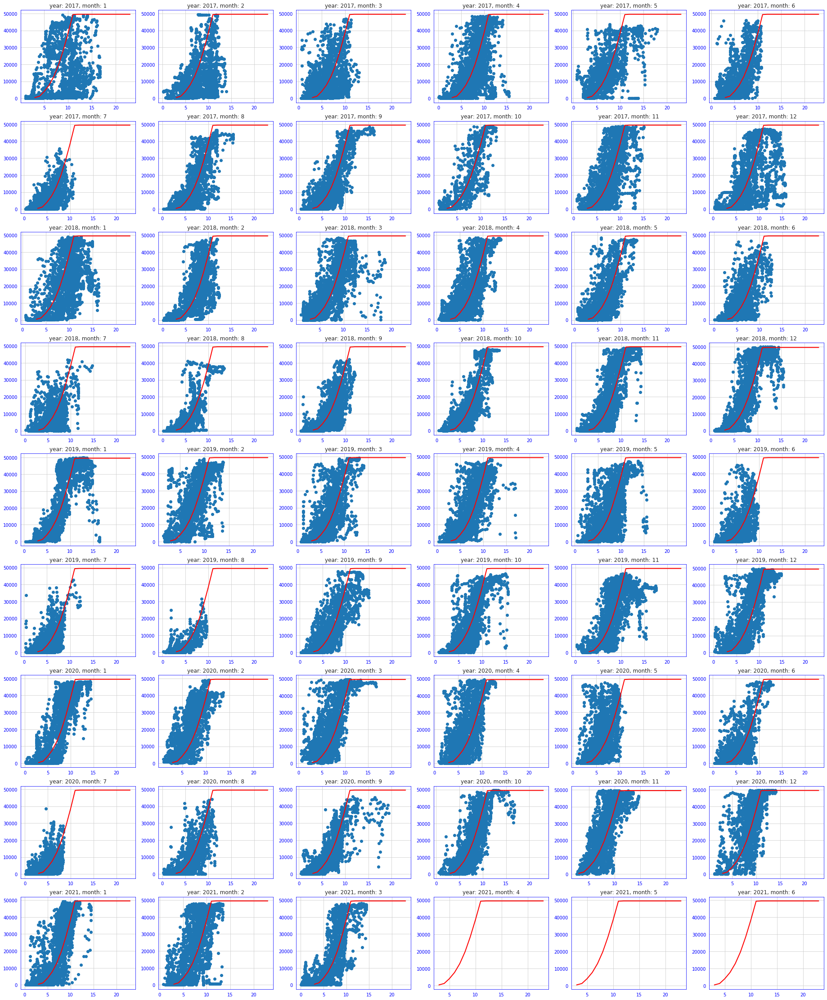

In [ ]:
years = ['2017', '2018', '2019', '2020', '2021']

fig , axs = plt.subplots(9, 6, figsize=(32, 40))
axs = axs.flatten()
i = 0
for yr, ax in zip(list(itertools.product(years, range(1,13))), axs):
    plot_data = df_model[(df_model.Date_Time.dt.strftime('%Y') == yr[0]) & (df_model.Month == yr[1])] 
    scat = ax.scatter(x=plot_data.Speed_100m, y=plot_data['Park Power [KW]'])
    ax.plot(power_curve*33, c='r', linewidth = 2)
    # ax.axis('off')
    ax.title.set_text(f'year: {yr[0]}, month: {yr[1]}')
    i += 1

plt.show()

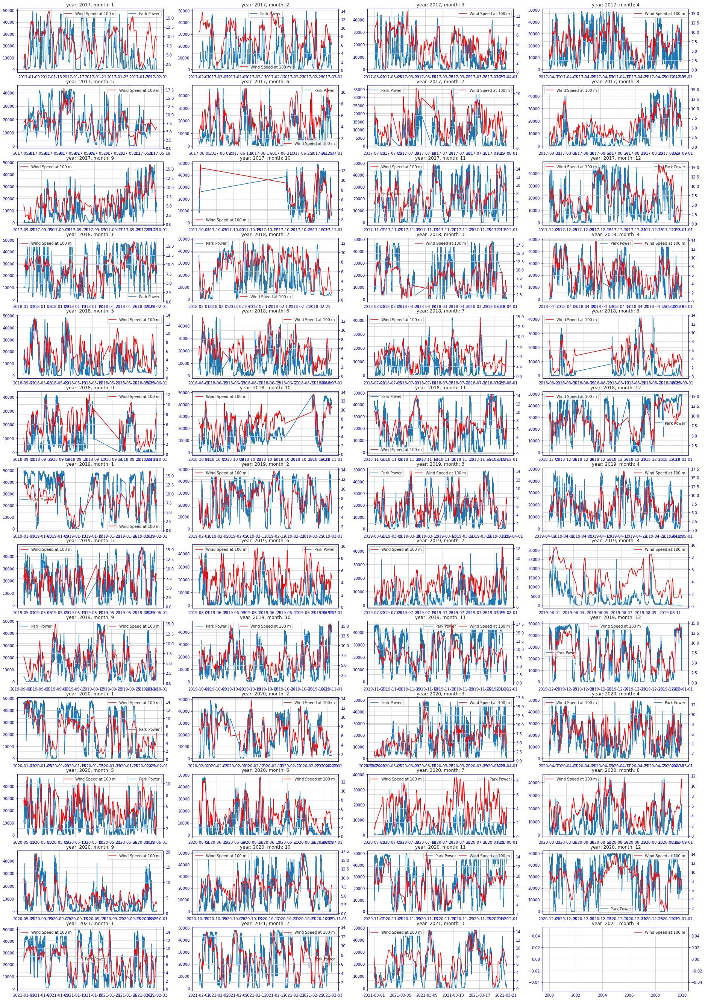

In [ ]:
years = ['2017', '2018', '2019', '2020', '2021']

fig , axs = plt.subplots(13, 4, figsize=(32, 48))
axs = axs.flatten()
i = 0
for yr, ax in zip(list(itertools.product(years, range(1,13))), axs):
    plot_data = df_model[(df_model.Date_Time.dt.strftime('%Y') == yr[0]) & (df_model.Month == yr[1])] 
    ax.plot(plot_data.Date_Time, plot_data['Park Power [KW]'], label='Park Power')
    ax.legend()
    ax2 = ax.twinx()
    ax2.plot(plot_data.Date_Time, plot_data.Speed_100m, c='r', label='Wind Speed at 100 m')
    # ax.axis('off')
    ax2.legend()
    ax.title.set_text(f'year: {yr[0]}, month: {yr[1]}')
    i += 1

plt.show()

# Model

## Feature ideas
- sine transform of direction

In [ ]:
df_model.shape

(126822, 8)

In [ ]:
df_model = df_model.set_index('Date_Time').drop(['Year', 'Month','Power_SD_12','Direction_100m','Air Density_100m'], axis=1)

In [ ]:
df_model

,Park Power [KW],Speed_100m
Date_Time,,
2017-01-08 01:45:00,2292.0,3.84
2017-01-08 02:00:00,876.0,3.90
2017-01-08 02:15:00,963.0,3.97
2017-01-08 02:30:00,850.0,4.06
2017-01-08 02:45:00,1427.0,4.16
...,...,...
2021-03-21 03:00:00,1859.0,6.01
2021-03-21 03:15:00,1287.0,5.88
2021-03-21 03:30:00,1132.0,5.74


In [ ]:
import torch
from torch.utils.data import Dataset

In [ ]:
features = list(df_model.columns.difference(target_variable))

In [ ]:
df_model.head()

,Park Power [KW],Speed_100m
Date_Time,,
2017-01-08 01:45:00,2292.0,3.84
2017-01-08 02:00:00,876.0,3.90
2017-01-08 02:15:00,963.0,3.97
2017-01-08 02:30:00,850.0,4.06
2017-01-08 02:45:00,1427.0,4.16


In [ ]:
sequence_length = 6

In [ ]:
df_model.head(20)

,Park Power [KW],Speed_100m
Date_Time,,
2017-01-08 01:45:00,2292.0,3.84
2017-01-08 02:00:00,876.0,3.90
2017-01-08 02:15:00,963.0,3.97
2017-01-08 02:30:00,850.0,4.06
2017-01-08 02:45:00,1427.0,4.16
2017-01-08 03:00:00,2272.0,4.27
2017-01-08 03:15:00,2335.0,4.38
2017-01-08 03:30:00,2406.0,4.49
2017-01-08 03:45:00,2269.0,4.60


In [ ]:
i = 10
i_start = i - sequence_length + 1
x = df_model.values[i_start:(i + 1), :]

In [ ]:
x

array([[2272.  ,    4.27],
       [2335.  ,    4.38],
       [2406.  ,    4.49],
       [2269.  ,    4.6 ],
       [1616.  ,    4.7 ],
       [1505.  ,    4.8 ]])

In [ ]:
test_start = "2020-04-01"

df_train = df_model.loc[:test_start].copy()
df_test = df_model.loc[test_start:].copy()

print("Test set fraction:", len(df_test) / len(df_model))

Test set fraction: 0.23628392550188454


In [ ]:
target_mean = df_train[target_variable].mean()
target_stdev = df_train[target_variable].std()

for c in df_train.columns:
    mean = df_train[c].mean()
    stdev = df_train[c].std()

    df_train[c] = (df_train[c] - mean) / stdev
    df_test[c] = (df_test[c] - mean) / stdev

In [ ]:
df_train.describe()

,Park Power [KW],Speed_100m
count,9.695200e+04,9.695200e+04
mean,4.246661e-15,4.212176e-14
std,1.000000e+00,1.000000e+00
min,-1.060027e+00,-2.260131e+00
25%,-8.566133e-01,-7.430215e-01
50%,-3.499243e-01,-1.642378e-02
75%,7.108183e-01,6.798990e-01
max,2.287441e+00,3.996683e+00


In [ ]:
import torch
from torch.utils.data import Dataset

class SequenceDataset(Dataset):
    def __init__(self, dataframe, target, features, sequence_length=5):
        self.features = features
        self.target = target
        self.sequence_length = sequence_length
        self.y = torch.tensor(dataframe[target].values).float()
        self.X = torch.tensor(dataframe[features].values).float()

    def __len__(self):
        return self.X.shape[0]

    def __getitem__(self, i): 
        if i >= self.sequence_length - 1:
            i_start = i - self.sequence_length + 1
            x = self.X[i_start:(i + 1), :]
        else:
            padding = self.X[0].repeat(self.sequence_length - i - 1, 1)
            x = self.X[0:(i + 1), :]
            x = torch.cat((padding, x), 0)

        return x, self.y[i]

In [ ]:
use_cuda = torch.cuda.is_available()
print("Running GPU.") if use_cuda else print("No GPU available.")


def get_variable(x):
    """ Converts tensors to cuda, if available. """
    if use_cuda:
        return x.cuda()
    return x


def get_numpy(x):
    """ Get numpy array for both cuda and not. """
    if use_cuda:
        return x.cpu().data.numpy()
    return x.data.numpy()

Running GPU.


In [ ]:
i = 30
sequence_length = 24

train_dataset = SequenceDataset(
    df_train,
    target=target_variable,
    features=features,
    sequence_length=sequence_length
)

X, y = train_dataset[i]
print(X)

tensor([[-0.7834],
        [-0.7464],
        [-0.7127],
        [-0.6791],
        [-0.6522],
        [-0.6286],
        [-0.6118],
        [-0.5984],
        [-0.5849],
        [-0.5748],
        [-0.5614],
        [-0.5513],
        [-0.5412],
        [-0.5345],
        [-0.5244],
        [-0.5176],
        [-0.5143],
        [-0.5109],
        [-0.5109],
        [-0.6152],
        [-0.7329],
        [-0.8776],
        [-1.0424],
        [-1.2173]])


In [ ]:
df_train.head(30)

,Park Power [KW],Speed_100m
Date_Time,,
2017-01-08 01:45:00,-0.906259,-1.002040
2017-01-08 02:00:00,-1.001257,-0.981857
2017-01-08 02:15:00,-0.995420,-0.958310
2017-01-08 02:30:00,-1.003001,-0.928035
2017-01-08 02:45:00,-0.964291,-0.894396
2017-01-08 03:00:00,-0.907601,-0.857393
2017-01-08 03:15:00,-0.903374,-0.820391
2017-01-08 03:30:00,-0.898611,-0.783388
2017-01-08 03:45:00,-0.907802,-0.746385


In [ ]:
X, y = train_dataset[i + 1]
print(X)

tensor([[-0.7464],
        [-0.7127],
        [-0.6791],
        [-0.6522],
        [-0.6286],
        [-0.6118],
        [-0.5984],
        [-0.5849],
        [-0.5748],
        [-0.5614],
        [-0.5513],
        [-0.5412],
        [-0.5345],
        [-0.5244],
        [-0.5176],
        [-0.5143],
        [-0.5109],
        [-0.5109],
        [-0.6152],
        [-0.7329],
        [-0.8776],
        [-1.0424],
        [-1.2173],
        [-1.3923]])


In [ ]:
print(df_train[features].iloc[(i - sequence_length + 1): (i + 1)])

                     Speed_100m
Date_Time                      
2017-01-08 03:30:00   -0.783388
2017-01-08 03:45:00   -0.746385
2017-01-08 04:00:00   -0.712747
2017-01-08 04:15:00   -0.679108
2017-01-08 04:30:00   -0.652197
2017-01-08 04:45:00   -0.628650
2017-01-08 05:00:00   -0.611830
2017-01-08 05:15:00   -0.598375
2017-01-08 05:30:00   -0.584919
2017-01-08 05:45:00   -0.574828
2017-01-08 06:00:00   -0.561372
2017-01-08 06:15:00   -0.551280
2017-01-08 06:30:00   -0.541189
2017-01-08 06:45:00   -0.534461
2017-01-08 07:00:00   -0.524369
2017-01-08 07:15:00   -0.517642
2017-01-08 07:30:00   -0.514278
2017-01-08 07:45:00   -0.510914
2017-01-08 08:00:00   -0.510914
2017-01-08 08:30:00   -0.615194
2017-01-08 08:45:00   -0.732930
2017-01-08 09:00:00   -0.877577
2017-01-08 09:15:00   -1.042407
2017-01-08 09:30:00   -1.217328


In [ ]:
from torch.utils.data import DataLoader
torch.manual_seed(99)

train_loader = DataLoader(train_dataset, batch_size=3, shuffle=True)

X, y = next(iter(train_loader))
print(X.shape)
print(X)

torch.Size([3, 24, 1])
tensor([[[-0.3764],
         [-0.3797],
         [-0.3797],
         [-0.3865],
         [-0.3898],
         [-0.3965],
         [-0.3999],
         [-0.4100],
         [-0.4167],
         [-0.4235],
         [-0.4335],
         [-0.4436],
         [-0.4638],
         [-0.4975],
         [-0.5446],
         [-0.6017],
         [-0.6623],
         [-0.7262],
         [-0.7901],
         [-0.8507],
         [-0.9718],
         [-0.9819],
         [-0.9751],
         [-0.9583]],

        [[ 0.3368],
         [ 0.3839],
         [ 0.4343],
         [ 0.4848],
         [ 0.5386],
         [ 0.5891],
         [ 0.6362],
         [ 0.6799],
         [ 0.7135],
         [ 0.7438],
         [ 0.7606],
         [ 0.7674],
         [ 0.7606],
         [ 0.7371],
         [ 0.7001],
         [ 0.6530],
         [ 0.6025],
         [ 0.5420],
         [ 0.4814],
         [ 0.4209],
         [ 0.3637],
         [ 0.3099],
         [ 0.2661],
         [ 0.2291]],

        [[ 2.

In [ ]:
torch.manual_seed(101)

batch_size = 16
sequence_length = 24

train_dataset = SequenceDataset(
    df_train,
    target=target_variable,
    features=features,
    sequence_length=sequence_length
)
test_dataset = SequenceDataset(
    df_test,
    target=target_variable,
    features=features,
    sequence_length=sequence_length
)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

X, y = next(iter(train_loader))

print("Features shape:", X.shape)
print("Target shape:", y.shape)

Features shape: torch.Size([16, 24, 1])
Target shape: torch.Size([16, 1])


In [ ]:
from torch import nn

class ShallowRegressionLSTM(nn.Module):
    def __init__(self, num_sensors, hidden_units):
        super().__init__()
        self.num_sensors = num_sensors  # this is the number of features
        self.hidden_units = hidden_units
        self.num_layers = 2

        self.lstm = nn.LSTM(
            input_size=num_sensors,
            hidden_size=hidden_units,
            batch_first=True,
            num_layers=self.num_layers
        )

        self.linear = nn.Linear(in_features=self.hidden_units, out_features=1)

    def forward(self, x):
        batch_size = x.shape[0]
        h0 = torch.zeros(self.num_layers, batch_size, self.hidden_units).requires_grad_().cuda()
        c0 = torch.zeros(self.num_layers, batch_size, self.hidden_units).requires_grad_().cuda()

        _, (hn, _) = self.lstm(x, (h0, c0))
        out = self.linear(hn[0]).flatten()  # First dim of Hn is num_layers, which is set to 1 above.

        return out.cuda()

In [ ]:
learning_rate = 1e-3
num_hidden_units = 50

model = ShallowRegressionLSTM(num_sensors=len(features), hidden_units=num_hidden_units)
if use_cuda:
    model.cuda()
loss_function = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

In [ ]:
def train_model(data_loader, model, loss_function, optimizer):
    num_batches = len(data_loader)
    total_loss = 0
    model.train()

    for X, y in data_loader:
        output = model(X.cuda())
        loss = loss_function(output, y.cuda())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    avg_loss = total_loss / num_batches
    print(f"Train loss: {avg_loss}")

def test_model(data_loader, model, loss_function):

    num_batches = len(data_loader)
    total_loss = 0

    model.eval()
    with torch.no_grad():
        for X, y in data_loader:
            output = model(X.cuda())
            total_loss += loss_function(output.cuda(), y.cuda()).item()

    avg_loss = total_loss / num_batches
    print(f"Test loss: {avg_loss}")


print("Untrained test\n--------")
test_model(test_loader, model, loss_function)
print()

for ix_epoch in range(5):
    print(f"Epoch {ix_epoch}\n---------")
    train_model(train_loader, model, loss_function, optimizer=optimizer)
    test_model(test_loader, model, loss_function)
    print()

Untrained test
--------


/usr/local/lib/python3.7/dist-packages/torch/nn/modules/loss.py:520: UserWarning: Using a target size (torch.Size([16, 1])) that is different to the input size (torch.Size([16])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/usr/local/lib/python3.7/dist-packages/torch/nn/modules/loss.py:520: UserWarning: Using a target size (torch.Size([14, 1])) that is different to the input size (torch.Size([14])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Test loss: 1.2223464022765957

Epoch 0
---------


/usr/local/lib/python3.7/dist-packages/torch/nn/modules/loss.py:520: UserWarning: Using a target size (torch.Size([8, 1])) that is different to the input size (torch.Size([8])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Train loss: 0.9985313659011334
Test loss: 1.0962729038689554

Epoch 1
---------
Train loss: 0.9982690004035585
Test loss: 1.0844413572131744

Epoch 2
---------
Train loss: 0.9981383736770932
Test loss: 1.0745942273196598

Epoch 3
---------
Train loss: 0.998206383319381
Test loss: 1.0658612976912798

Epoch 4
---------
Train loss: 0.9982337533124406
Test loss: 1.0801618371931543



In [ ]:
def predict(data_loader, model):

    output = torch.tensor([]).cuda()
    model.eval()
    with torch.no_grad():
        for X, _ in data_loader:
            y_star = model(X.cuda())
            output = torch.cat((output, y_star), 0)

    return output


train_eval_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False)

ystar_col = "Model forecast"
df_train[ystar_col] = predict(train_eval_loader, model).cpu().numpy()
df_test[ystar_col] = predict(test_loader, model).cpu().numpy()

df_out = pd.concat((df_train, df_test))[['Park Power [KW]', ystar_col]]

for c in df_out.columns:
    df_out[c] = df_out[c] * target_stdev.values + target_mean.values

print(df_out)

                     Park Power [KW]  Model forecast
Date_Time                                           
2017-01-08 01:45:00           2292.0    14967.857387
2017-01-08 02:00:00            876.0    14971.545090
2017-01-08 02:15:00            963.0    14977.191477
2017-01-08 02:30:00            850.0    14985.066522
2017-01-08 02:45:00           1427.0    14994.714898
...                              ...             ...
2021-03-21 03:00:00           1859.0    15359.406182
2021-03-21 03:15:00           1287.0    15327.155768
2021-03-21 03:30:00           1132.0    15293.643210
2021-03-21 03:45:00            356.0    15259.390746
2021-03-21 04:00:00             86.0    15226.066816

[126918 rows x 2 columns]


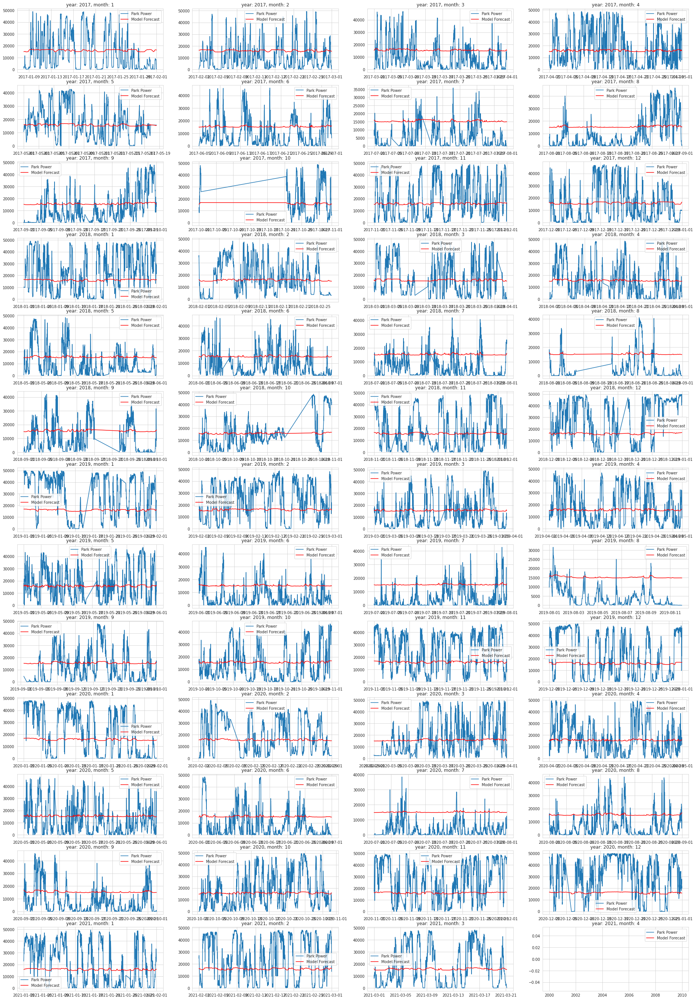

In [ ]:
years = ['2017', '2018', '2019', '2020', '2021']

fig , axs = plt.subplots(13, 4, figsize=(32, 48))
axs = axs.flatten()
i = 0

df_out.reset_index(inplace=True)
for yr, ax in zip(list(itertools.product(years, range(1,13))), axs):
    plot_data = df_out[(df_out.Date_Time.dt.strftime('%Y') == yr[0]) & (pd.DatetimeIndex(df_out.Date_Time).month == yr[1])] 
    ax.plot(plot_data.Date_Time, plot_data['Park Power [KW]'], label='Park Power')
    ax.plot(plot_data.Date_Time, plot_data['Model forecast'], c='r', label='Model Forecast')
    # ax.axis('off')
    ax.legend()
    ax.title.set_text(f'year: {yr[0]}, month: {yr[1]}')
    i += 1

plt.show()

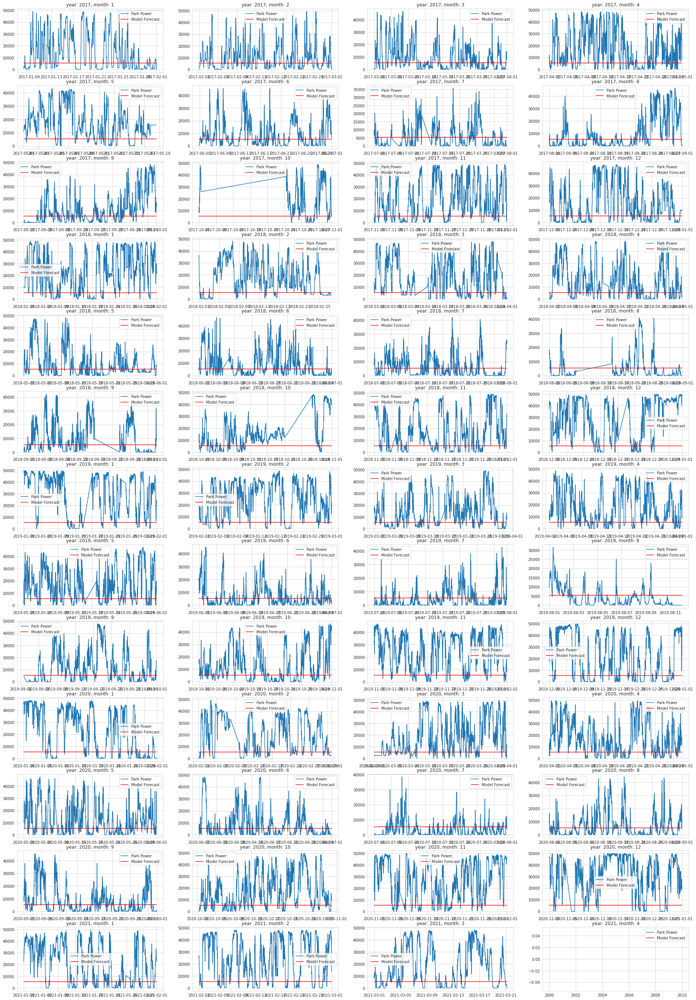

In [ ]:
years = ['2017', '2018', '2019', '2020', '2021']

fig , axs = plt.subplots(13, 4, figsize=(32, 48))
axs = axs.flatten()
i = 0

df_out.reset_index(inplace=True)
for yr, ax in zip(list(itertools.product(years, range(1,13))), axs):
    plot_data = df_out[(df_out.Date_Time.dt.strftime('%Y') == yr[0]) & (pd.DatetimeIndex(df_out.Date_Time).month == yr[1])] 
    ax.plot(plot_data.Date_Time, plot_data['Park Power [KW]'], label='Park Power')
    ax.plot(plot_data.Date_Time, plot_data['Model forecast'], c='r', label='Model Forecast')
    # ax.axis('off')
    ax.legend()
    ax.title.set_text(f'year: {yr[0]}, month: {yr[1]}')
    i += 1

plt.show()

### Questions

- Using power curve as a feature
- Removing NAs
- Removing stationary periods
- Creating the dataset input
- Splitting into train and test
- Scaling the data
- Scaling the predictions
- Speeding up the process
- Addressing the gaps
- Different NNs
- Addressing other cases


# Pipeline 2

In [ ]:
target_variable = ['Park Power [KW]']
model_cols = ['Date_Time', 'Month', 'Year', 'Speed_100m', 'Direction_100m','Air Density_100m','Speed_50m', 'Direction_50m','Air Density_50m','Speed_10m_nwp']
final_cols = ['Speed_100m', 'Direction_100m','Air Density_100m','Speed_50m', 'Direction_50m','Air Density_50m','Speed_10m_nwp']

In [ ]:
df_model = df_full[target_variable+model_cols]
df_model.dropna(inplace=True)
df_model = df_model[~(df_model['Park Power [KW]'] < 0)]
df_model = df_model[~((df_model.Speed_100m > 4) & (df_model['Park Power [KW]'] == 0))]
df_model['Power_SD_12'] = SD_N(df_model['Park Power [KW]'], 12)
df_model = df_model[~(df_model['Power_SD_12'] == 0)]
df_model.set_index('Date_Time', inplace = True)
df_model = df_model.loc[:, target_variable+final_cols]
df_model.shape

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


(126822, 8)

In [ ]:
df_model.head()

,Park Power [KW],Speed_100m,Direction_100m,Air Density_100m,Speed_50m,Direction_50m,Air Density_50m,Speed_10m_nwp
Date_Time,,,,,,,,
2017-01-08 01:45:00,2292.0,3.84,183,1.370,3.00,181,1.370,3.19
2017-01-08 02:00:00,876.0,3.90,183,1.370,3.00,180,1.370,3.20
2017-01-08 02:15:00,963.0,3.97,183,1.370,3.00,180,1.370,3.21
2017-01-08 02:30:00,850.0,4.06,182,1.369,3.01,178,1.369,3.23
2017-01-08 02:45:00,1427.0,4.16,181,1.369,3.02,176,1.369,3.25


In [ ]:
target_mean = df_model[target_variable].mean()
target_stdev = df_model[target_variable].std()

for c in df_model.columns:
    mean = df_model[c].mean()
    stdev = df_model[c].std()

    df_model[c] = (df_model[c] - mean) / stdev

In [ ]:
df_model.describe()

,Park Power [KW],Speed_100m,Direction_100m
count,1.268220e+05,1.268220e+05,1.268220e+05
mean,-5.393153e-15,1.007439e-14,-6.748022e-16
std,1.000000e+00,1.000000e+00,1.000000e+00
min,-1.068342e+00,-2.279605e+00,-2.898037e+00
25%,-8.622061e-01,-7.430187e-01,-4.176992e-01
50%,-3.499017e-01,-1.228636e-02,4.263947e-01
75%,7.421982e-01,6.877142e-01,5.822274e-01
max,2.225086e+00,4.314059e+00,1.763959e+00


In [ ]:
X.shape

(126822, 2)

In [ ]:
y = df_model['Park Power [KW]']
X = df_model[final_cols]

In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
mm = MinMaxScaler()
ss = StandardScaler()


X_ss = ss.fit_transform(X)
y_mm = mm.fit_transform(y.to_numpy().reshape(-1, 1))

In [ ]:
#first 100000 for training

X_train = X_ss[:100000, :]
X_test = X_ss[100000:, :]

y_train = y_mm[:100000, :]
y_test = y_mm[100000:, :] 

In [ ]:
print("Training Shape", X_train.shape, y_train.shape)
print("Testing Shape", X_test.shape, y_test.shape) 

Training Shape (100000, 7) (100000, 1)
Testing Shape (26822, 7) (26822, 1)


In [ ]:
import torch #pytorch
import torch.nn as nn
from torch.autograd import Variable 

In [ ]:
X_train_tensors = Variable(torch.Tensor(X_train))
X_test_tensors = Variable(torch.Tensor(X_test))

y_train_tensors = Variable(torch.Tensor(y_train))
y_test_tensors = Variable(torch.Tensor(y_test)) 

In [ ]:
#reshaping to rows, timestamps, features

X_train_tensors_final = torch.reshape(X_train_tensors,   (X_train_tensors.shape[0], 1, X_train_tensors.shape[1]))


X_test_tensors_final = torch.reshape(X_test_tensors,  (X_test_tensors.shape[0], 1, X_test_tensors.shape[1])) 

In [ ]:
print("Training Shape", X_train_tensors_final.shape, y_train_tensors.shape)
print("Testing Shape", X_test_tensors_final.shape, y_test_tensors.shape) 

Training Shape torch.Size([100000, 1, 7]) torch.Size([100000, 1])
Testing Shape torch.Size([26822, 1, 7]) torch.Size([26822, 1])


In [ ]:
class LSTM1(nn.Module):
    def __init__(self, num_classes, input_size, hidden_size, num_layers, seq_length):
        super(LSTM1, self).__init__()
        self.num_classes = num_classes #number of classes
        self.num_layers = num_layers #number of layers
        self.input_size = input_size #input size
        self.hidden_size = hidden_size #hidden state
        self.seq_length = seq_length #sequence length

        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size,
                          num_layers=num_layers, batch_first=True) #lstm
        self.fc_1 =  nn.Linear(hidden_size, 256) #fully connected 1
        self.fc = nn.Linear(256, num_classes) #fully connected last layer

        self.relu = nn.ReLU()
    
    def forward(self,x):
        h_0 = Variable(torch.zeros(self.num_layers, x.size(0), self.hidden_size)) #hidden state
        c_0 = Variable(torch.zeros(self.num_layers, x.size(0), self.hidden_size)) #internal state
        # Propagate input through LSTM
        output, (hn, cn) = self.lstm(x, (h_0, c_0)) #lstm with input, hidden, and internal state
        hn = hn.view(-1, self.hidden_size) #reshaping the data for Dense layer next
        out = self.relu(hn)
        out = self.fc_1(out) #first Dense
        out = self.relu(out) #relu
        out = self.fc(out) #Final Output
        return out

In [ ]:
num_epochs = 1000 #1000 epochs
learning_rate = 0.001 #0.001 lr

input_size = 7 #number of features
hidden_size = 2 #number of features in hidden state
num_layers = 1 #number of stacked lstm layers

num_classes = 1 #number of output classes 

In [ ]:
lstm1 = LSTM1(num_classes, input_size, hidden_size, num_layers, X_train_tensors_final.shape[1]) #our lstm class 

In [ ]:
criterion = torch.nn.MSELoss()    # mean-squared error for regression
optimizer = torch.optim.Adam(lstm1.parameters(), lr=learning_rate)

In [ ]:
for epoch in range(num_epochs):
  outputs = lstm1.forward(X_train_tensors_final) #forward pass
  optimizer.zero_grad() #caluclate the gradient, manually setting to 0
 
  # obtain the loss function
  loss = criterion(outputs, y_train_tensors)
 
  loss.backward() #calculates the loss of the loss function
 
  optimizer.step() #improve from loss, i.e backprop
  if epoch % 1 == 0:
    print("Epoch: %d, loss: %1.5f" % (epoch, loss.item())) 

Epoch: 0, loss: 0.36783
Epoch: 1, loss: 0.32081
Epoch: 2, loss: 0.27835
Epoch: 3, loss: 0.24049
Epoch: 4, loss: 0.20725
Epoch: 5, loss: 0.17858
Epoch: 6, loss: 0.15441
Epoch: 7, loss: 0.13460
Epoch: 8, loss: 0.11894
Epoch: 9, loss: 0.10717
Epoch: 10, loss: 0.09895
Epoch: 11, loss: 0.09385
Epoch: 12, loss: 0.09141
Epoch: 13, loss: 0.09109
Epoch: 14, loss: 0.09234
Epoch: 15, loss: 0.09459
Epoch: 16, loss: 0.09733
Epoch: 17, loss: 0.10011
Epoch: 18, loss: 0.10257
Epoch: 19, loss: 0.10443
Epoch: 20, loss: 0.10555
Epoch: 21, loss: 0.10586
Epoch: 22, loss: 0.10541
Epoch: 23, loss: 0.10427
Epoch: 24, loss: 0.10259
Epoch: 25, loss: 0.10052
Epoch: 26, loss: 0.09824
Epoch: 27, loss: 0.09590
Epoch: 28, loss: 0.09364
Epoch: 29, loss: 0.09157
Epoch: 30, loss: 0.08979
Epoch: 31, loss: 0.08832
Epoch: 32, loss: 0.08719
Epoch: 33, loss: 0.08639
Epoch: 34, loss: 0.08586
Epoch: 35, loss: 0.08556
Epoch: 36, loss: 0.08542
Epoch: 37, loss: 0.08537
Epoch: 38, loss: 0.08534
Epoch: 39, loss: 0.08528
Epoch: 40,

In [ ]:
df_X_ss = ss.transform(df_model[final_cols]) #old transformers
df_y_mm = mm.transform(df_model['Park Power [KW]'].to_numpy().reshape(-1, 1)) #old transformers

df_X_ss = Variable(torch.Tensor(df_X_ss)) #converting to Tensors
df_y_mm = Variable(torch.Tensor(df_y_mm))
#reshaping the dataset
df_X_ss = torch.reshape(df_X_ss, (df_X_ss.shape[0], 1, df_X_ss.shape[1])) 

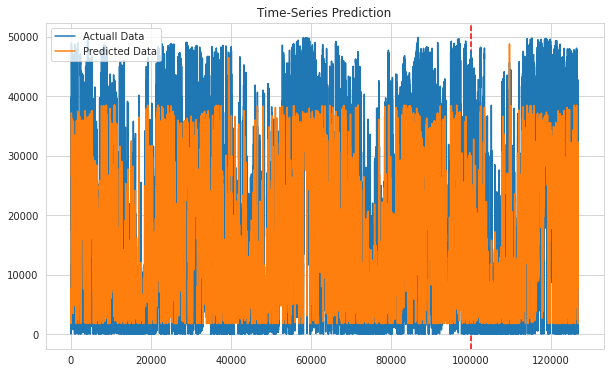

In [ ]:
train_predict = lstm1(df_X_ss)#forward pass
data_predict = train_predict.data.numpy() #numpy conversion
dataY_plot = df_y_mm.data.numpy()

data_predict = mm.inverse_transform(data_predict) #reverse transformation
dataY_plot = mm.inverse_transform(dataY_plot)
plt.figure(figsize=(10,6)) #plotting
plt.axvline(x=100000, c='r', linestyle='--') #size of the training set

plt.plot(dataY_plot, label='Actuall Data') #actual plot
plt.plot(data_predict, label='Predicted Data') #predicted plot
plt.title('Time-Series Prediction')
plt.legend()
plt.show() 

In [ ]:
sequence_length = 6

In [ ]:
i = 10
i_start = i - sequence_length + 1
x = X.values[i_start:(i + 1), :]
y_seq = y.values[i]

In [ ]:
x

array([[-0.85570169, -0.57353195],
       [-0.81814068, -0.58651801],
       [-0.78057967, -0.61249013],
       [-0.74301867, -0.63846225],
       [-0.7088723 , -0.65144831],
       [-0.67472593, -0.67742043]])

In [ ]:
df_model.head(12)

,Park Power [KW],Speed_100m,Direction_100m
Date_Time,,,
2017-01-08 01:45:00,-0.917057,-1.002531,-0.521588
2017-01-08 02:00:00,-1.010521,-0.982043,-0.521588
2017-01-08 02:15:00,-1.004779,-0.958141,-0.521588
2017-01-08 02:30:00,-1.012237,-0.927409,-0.534574
2017-01-08 02:45:00,-0.974152,-0.893263,-0.547560
2017-01-08 03:00:00,-0.918377,-0.855702,-0.573532
2017-01-08 03:15:00,-0.914219,-0.818141,-0.586518
2017-01-08 03:30:00,-0.909532,-0.780580,-0.612490
2017-01-08 03:45:00,-0.918575,-0.743019,-0.638462


In [ ]:
X.head(12)

,Speed_100m,Direction_100m
Date_Time,,
2017-01-08 01:45:00,-1.002531,-0.521588
2017-01-08 02:00:00,-0.982043,-0.521588
2017-01-08 02:15:00,-0.958141,-0.521588
2017-01-08 02:30:00,-0.927409,-0.534574
2017-01-08 02:45:00,-0.893263,-0.547560
2017-01-08 03:00:00,-0.855702,-0.573532
2017-01-08 03:15:00,-0.818141,-0.586518
2017-01-08 03:30:00,-0.780580,-0.612490
2017-01-08 03:45:00,-0.743019,-0.638462


In [ ]:
y[10]

-0.969003537646272

In [ ]:
X_train = X.iloc[:100000, :]
X_test = X.iloc[100000:, :]

y_train = y.iloc[:100000]
y_test = y.iloc[1000000:] 

In [ ]:
y_test

Series([], Name: Park Power [KW], dtype: float64)

# Pipeline 3

In [ ]:
df = pd.read_csv(datasets_path+'Case1/Proj_NWP_Case1.csv')
df.Date_Time = pd.to_datetime(df.Date_Time)

In [ ]:
dfm = pd.read_csv(datasets_path+'Case1/Proj_Measurements_Case1.csv')
dfm.Date_Time = pd.to_datetime(dfm.Date_Time)

In [ ]:
# df_full = dfm.add_suffix('_m').join(df.add_suffix('_nwp'))
df_full = dfm.merge(df, on = "Date_Time", suffixes=('_m', '_nwp'))
df_full['Month'] = pd.DatetimeIndex(df_full.Date_Time).month
df_full['Year'] = pd.DatetimeIndex(df_full.Date_Time).year
df_full['Day'] = pd.DatetimeIndex(df_full.Date_Time).day
df_full.head(3)

,Date_Time,Speed_10m_m,Direction_10m_m,Speed_30m,Direction_30m,Speed_65m,Direction_65m,Speed_70m,Direction_70m,Speed_80m,Direction_80m,Park Power [KW],Direction_10m_nwp,Speed_10m_nwp,Temperature_10m,Pressure_seaLevel,Air Density_10m,Direction_50m,Speed_50m,Temperature_50m,Air Density_50m,Direction_100m,Speed_100m,Temperature_100m,Air Density_100m,Direction_150m,Speed_150m,Temperature_150m,Air Density_150m,Month,Year,Day
0,2017-01-07 20:15:00,2.950,96.4,1.800,89.6,3.300,200.0,3.400,187.1,0.0,0.0,NaN,171,1.43,-16.91,1005.28,1.367,170,1.53,-16.91,1.367,174,1.04,-16.91,1.367,185,0.65,-16.91,1.367,1,2017,7
1,2017-01-07 20:30:00,2.967,91.3,3.033,77.1,2.467,194.5,2.833,178.6,0.0,0.0,NaN,172,1.52,-17.15,1005.24,1.368,172,1.62,-17.15,1.368,170,1.15,-17.15,1.368,165,0.80,-17.15,1.368,1,2017,7
2,2017-01-07 20:45:00,3.167,86.1,2.667,65.3,1.767,178.8,2.067,160.7,0.0,0.0,NaN,173,1.66,-17.40,1005.17,1.369,173,1.75,-17.40,1.369,166,1.31,-17.40,1.369,155,1.02,-17.40,1.369,1,2017,7


In [ ]:
target_variable = ['Park Power [KW]']
model_cols = ['Date_Time', 'Month', 'Year', 'Speed_100m', 'Direction_100m','Air Density_100m','Speed_50m', 'Direction_50m','Air Density_50m','Speed_10m_nwp']
final_cols = ['Speed_100m', 'Direction_100m','Air Density_100m','Speed_50m', 'Direction_50m','Air Density_50m','Speed_10m_nwp']

In [ ]:
df_model = df_full[target_variable+model_cols]
df_model.dropna(inplace=True)
df_model = df_model[~(df_model['Park Power [KW]'] < 0)]
df_model = df_model[~((df_model.Speed_100m > 4) & (df_model['Park Power [KW]'] == 0))]
df_model['Power_SD_12'] = SD_N(df_model['Park Power [KW]'], 12)
df_model = df_model[~(df_model['Power_SD_12'] == 0)]
df_model.set_index('Date_Time', inplace = True)
df_model = df_model.loc[:, target_variable+final_cols]
df_model.shape

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


(126822, 8)

In [ ]:
df_model.head()

,Park Power [KW],Speed_100m,Direction_100m,Air Density_100m,Speed_50m,Direction_50m,Air Density_50m,Speed_10m_nwp
Date_Time,,,,,,,,
2017-01-08 01:45:00,2292.0,3.84,183,1.370,3.00,181,1.370,3.19
2017-01-08 02:00:00,876.0,3.90,183,1.370,3.00,180,1.370,3.20
2017-01-08 02:15:00,963.0,3.97,183,1.370,3.00,180,1.370,3.21
2017-01-08 02:30:00,850.0,4.06,182,1.369,3.01,178,1.369,3.23
2017-01-08 02:45:00,1427.0,4.16,181,1.369,3.02,176,1.369,3.25


In [ ]:
y = df_model['Park Power [KW]']
X = df_model[final_cols]

In [ ]:
sequence_length = 96

In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
mm = MinMaxScaler()
ss = StandardScaler()


X_ss = ss.fit_transform(X)
y_mm = mm.fit_transform(y.to_numpy().reshape(-1, 1))
y_mm = y_mm[sequence_length:]

In [ ]:
X_seq = []
for i in range(0, X.shape[0]):
    if i >= sequence_length:
        i_start = i - sequence_length + 1
        x = X_ss[i_start:(i + 1), :]
        X_seq.append(x)

In [ ]:
X_seq = np.asarray(X_seq)

In [ ]:
from sklearn.model_selection import train_test_split
def train_val_test_split(X, y, target_col, test_ratio):
    val_ratio = test_ratio / (1 - test_ratio)
    # X, y = feature_label_split(df, target_col)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_ratio, shuffle=True)
    X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=val_ratio, shuffle=True)
    return X_train, X_val, X_test, y_train, y_val, y_test

X_train, X_val, X_test, y_train, y_val, y_test = train_val_test_split(X_seq, y_mm, 'value', 0.2)

In [ ]:
#first 100000 for training

X_train = X_seq[:100000, :]
X_test = X_seq[100000:, :]

y_train = y_mm[:100000, :]
y_test = y_mm[100000:, :] 

In [ ]:
print("Training Shape", X_train.shape, y_train.shape)
print("Validation Shape", X_val.shape, y_val.shape) 
print("Testing Shape", X_test.shape, y_test.shape) 

Training Shape (76035, 96, 7) (76035, 1)
Validation Shape (25345, 96, 7) (25345, 1)
Testing Shape (25346, 96, 7) (25346, 1)


In [ ]:
import torch #pytorch
import torch.nn as nn
from torch.autograd import Variable 

In [ ]:
X_train_tensors = Variable(torch.Tensor(X_train))
X_val_tensors = Variable(torch.Tensor(X_val))
X_test_tensors = Variable(torch.Tensor(X_test))

y_train_tensors = Variable(torch.Tensor(y_train))
y_val_tensors = Variable(torch.Tensor(y_val))
y_test_tensors = Variable(torch.Tensor(y_test)) 

In [ ]:
from torch.utils.data import TensorDataset, DataLoader

batch_size = 64

train = TensorDataset(X_train_tensors, y_train_tensors)
val = TensorDataset(X_val_tensors, y_val_tensors)
test = TensorDataset(X_test_tensors, y_test_tensors)

train_loader = DataLoader(train, batch_size=batch_size, shuffle=False, drop_last=True)
val_loader = DataLoader(val, batch_size=batch_size, shuffle=False, drop_last=True)
test_loader = DataLoader(test, batch_size=batch_size, shuffle=False, drop_last=True)
test_loader_one = DataLoader(test, batch_size=1, shuffle=False, drop_last=True)

In [ ]:
print("Training Shape", X_train_tensors_final.shape, y_train_tensors.shape)
print("Testing Shape", X_test_tensors_final.shape, y_test_tensors.shape) 

Training Shape torch.Size([100000, 96, 7]) torch.Size([100000, 1])
Testing Shape torch.Size([26725, 96, 7]) torch.Size([26822, 1])


In [ ]:
class LSTM1(nn.Module):
    def __init__(self, num_classes, input_size, hidden_size, num_layers, seq_length):
        super(LSTM1, self).__init__()
        self.num_classes = num_classes #number of classes
        self.num_layers = num_layers #number of layers
        self.input_size = input_size #input size
        self.hidden_size = hidden_size #hidden state
        self.seq_length = seq_length #sequence length

        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size,
                          num_layers=num_layers, batch_first=True) #lstm
        self.fc_1 =  nn.Linear(hidden_size, 256) #fully connected 1
        self.fc = nn.Linear(256, num_classes) #fully connected last layer

        self.relu = nn.ReLU()
    
    def forward(self,x):
        h_0 = Variable(torch.zeros(self.num_layers, x.size(0), self.hidden_size)) #hidden state
        c_0 = Variable(torch.zeros(self.num_layers, x.size(0), self.hidden_size)) #internal state
        # Propagate input through LSTM
        output, (hn, cn) = self.lstm(x, (h_0, c_0)) #lstm with input, hidden, and internal state
        hn = hn.view(-1, self.hidden_size) #reshaping the data for Dense layer next
        out = self.relu(hn)
        out = self.fc_1(out) #first Dense
        out = self.relu(out) #relu
        out = self.fc(out) #Final Output
        return out

In [ ]:
class Optimization:
    def __init__(self, model, loss_fn, optimizer):
        self.model = model
        self.loss_fn = loss_fn
        self.optimizer = optimizer
        self.train_losses = []
        self.val_losses = []
    
    def train_step(self, x, y):
        # Sets model to train mode
        self.model.train()

        # Makes predictions
        yhat = self.model(x)

        # Computes loss
        loss = self.loss_fn(y, yhat)

        # Computes gradients
        loss.backward()

        # Updates parameters and zeroes gradients
        self.optimizer.step()
        self.optimizer.zero_grad()

        # Returns the loss
        return loss.item()

    def train(self, train_loader, val_loader, batch_size=64, n_epochs=50, n_features=1):
        model_path = f'models/{self.model}_{datetime.now().strftime("%Y-%m-%d %H:%M:%S")}'

        for epoch in range(1, n_epochs + 1):
            batch_losses = []
            for x_batch, y_batch in train_loader:
                x_batch = x_batch.view([batch_size, -1, n_features]).to(device)
                y_batch = y_batch.to(device)
                loss = self.train_step(x_batch, y_batch)
                batch_losses.append(loss)
            training_loss = np.mean(batch_losses)
            self.train_losses.append(training_loss)

            with torch.no_grad():
                batch_val_losses = []
                for x_val, y_val in val_loader:
                    x_val = x_val.view([batch_size, -1, n_features]).to(device)
                    y_val = y_val.to(device)
                    self.model.eval()
                    yhat = self.model(x_val)
                    val_loss = self.loss_fn(y_val, yhat).item()
                    batch_val_losses.append(val_loss)
                validation_loss = np.mean(batch_val_losses)
                self.val_losses.append(validation_loss)

            if (epoch <= 10) | (epoch % 50 == 0):
                print(
                    f"[{epoch}/{n_epochs}] Training loss: {training_loss:.4f}\t Validation loss: {validation_loss:.4f}"
                )

        # torch.save(self.model.state_dict(), model_path)


    def evaluate(self, test_loader, batch_size=1, n_features=1):
        with torch.no_grad():
            predictions = []
            values = []
            for x_test, y_test in test_loader:
                x_test = x_test.view([batch_size, -1, n_features]).to(device)
                y_test = y_test.to(device)
                self.model.eval()
                yhat = self.model(x_test)
                predictions.append(yhat.to(device).detach().numpy())
                values.append(y_test.to(device).detach().numpy())

        return predictions, values

    def plot_losses(self):
        plt.plot(self.train_losses, label="Training loss")
        plt.plot(self.val_losses, label="Validation loss")
        plt.legend()
        plt.title("Losses")
        plt.show()
        plt.close()

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

[1/10] Training loss: 0.0415	 Validation loss: 0.0392
[2/10] Training loss: 0.0384	 Validation loss: 0.0385
[3/10] Training loss: 0.0380	 Validation loss: 0.0381
[4/10] Training loss: 0.0377	 Validation loss: 0.0378
[5/10] Training loss: 0.0373	 Validation loss: 0.0371
[6/10] Training loss: 0.0369	 Validation loss: 0.0367
[7/10] Training loss: 0.0365	 Validation loss: 0.0364
[8/10] Training loss: 0.0360	 Validation loss: 0.0360
[9/10] Training loss: 0.0354	 Validation loss: 0.0355
[10/10] Training loss: 0.0349	 Validation loss: 0.0351


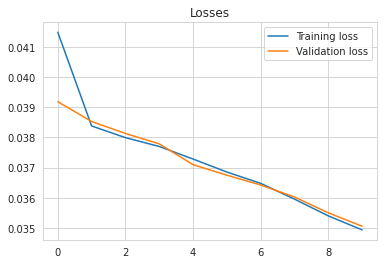

In [ ]:
import torch.optim as optim
from datetime import datetime
input_dim = 7 #len(X_train.columns)
output_dim = 1
hidden_dim = 64
layer_dim = 3
batch_size = 64
dropout = 0.2
n_epochs = 10
learning_rate = 1e-3
weight_decay = 1e-6

# model_params = {'input_dim': input_dim,
#                 'hidden_dim' : hidden_dim,
#                 'layer_dim' : layer_dim,
#                 'output_dim' : output_dim,
#                 'dropout_prob' : dropout}

input_size = 7 #number of features
hidden_size = 5 #number of features in hidden state
num_layers = 1 #number of stacked lstm layers

num_classes = 1 #number of output classes 

model = LSTM1(num_classes, input_size, hidden_size, num_layers, X_train_tensors.shape[1]) #our lstm class 

loss_fn = nn.MSELoss(reduction="mean")
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)

opt = Optimization(model=model, loss_fn=loss_fn, optimizer=optimizer)
opt.train(train_loader, val_loader, batch_size=batch_size, n_epochs=n_epochs, n_features=input_dim)
opt.plot_losses()

predictions, values = opt.evaluate(test_loader_one, batch_size=1, n_features=input_dim)

In [ ]:
vals = np.concatenate(values, axis=0).ravel()
preds = np.concatenate(predictions, axis=0).ravel()

In [ ]:
vals.shape

(25346,)

In [ ]:
preds.shape

(25346,)

In [ ]:
def inverse_transform(scaler, df, columns):
    for col in columns:
        df[col] = scaler.inverse_transform(df[col])
    return df


def format_predictions(predictions, values, df_test, scaler):
    vals = np.concatenate(values, axis=0).ravel()
    preds = np.concatenate(predictions, axis=0).ravel()
    df_result = pd.DataFrame(data={"value": vals, "prediction": preds})
    df_result = df_result.sort_index()
    df_result = inverse_transform(scaler, df_result, [["value", "prediction"]])
    return df_result


df_result = format_predictions(predictions, values, X_test, mm)

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def calculate_metrics(df):
    return {'mae' : mean_absolute_error(df.value, df.prediction),
            'rmse' : mean_squared_error(df.value, df.prediction) ** 0.5,
            'r2' : r2_score(df.value, df.prediction)}

result_metrics = calculate_metrics(df_result)
result_metrics

{'mae': 7430.2295, 'r2': 0.6055280245537561, 'rmse': 10166.901592914137}

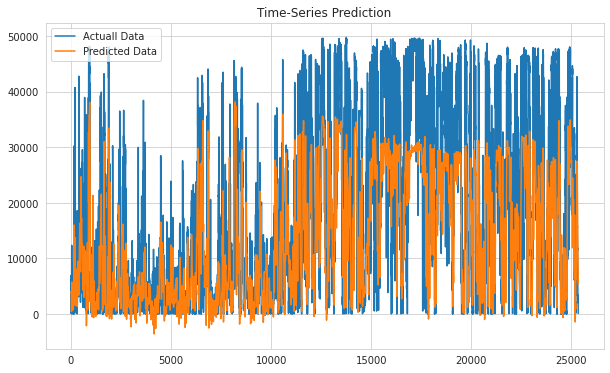

In [ ]:
train_predict = model(X_test_tensors)#forward pass
data_predict = train_predict.data.numpy() #numpy conversion
dataY_plot = y_test

data_predict = mm.inverse_transform(data_predict) #reverse transformation
dataY_plot = mm.inverse_transform(dataY_plot)
plt.figure(figsize=(10,6)) #plotting
# plt.axvline(x=100000, c='r', linestyle='--') #size of the training set

plt.plot(dataY_plot, label='Actuall Data') #actual plot
plt.plot(data_predict, label='Predicted Data') #predicted plot
plt.title('Time-Series Prediction')
plt.legend()
plt.show() 

In [ ]:
num_epochs = 1000 #1000 epochs
learning_rate = 0.001 #0.001 lr

input_size = 7 #number of features
hidden_size = 5 #number of features in hidden state
num_layers = 1 #number of stacked lstm layers

num_classes = 1 #number of output classes 

In [ ]:
lstm1 = LSTM1(num_classes, input_size, hidden_size, num_layers, X_train_tensors_final.shape[1]) #our lstm class 

In [ ]:
criterion = torch.nn.MSELoss()    # mean-squared error for regression
optimizer = torch.optim.Adam(lstm1.parameters(), lr=learning_rate)

In [ ]:
for epoch in range(num_epochs):
  outputs = lstm1.forward(X_train_tensors_final) #forward pass
  optimizer.zero_grad() #caluclate the gradient, manually setting to 0
 
  # obtain the loss function
  loss = criterion(outputs, y_train_tensors)
 
  loss.backward() #calculates the loss of the loss function
 
  optimizer.step() #improve from loss, i.e backprop
  if epoch % 1 == 0:
    print("Epoch: %d, loss: %1.5f" % (epoch, loss.item())) 

Epoch: 0, loss: 0.20450
Epoch: 1, loss: 0.17964
Epoch: 2, loss: 0.15824
Epoch: 3, loss: 0.14033
Epoch: 4, loss: 0.12587
Epoch: 5, loss: 0.11475
Epoch: 6, loss: 0.10675
Epoch: 7, loss: 0.10154
Epoch: 8, loss: 0.09870
Epoch: 9, loss: 0.09772
Epoch: 10, loss: 0.09804
Epoch: 11, loss: 0.09910
Epoch: 12, loss: 0.10039
Epoch: 13, loss: 0.10149
Epoch: 14, loss: 0.10214
Epoch: 15, loss: 0.10217
Epoch: 16, loss: 0.10158
Epoch: 17, loss: 0.10043
Epoch: 18, loss: 0.09886
Epoch: 19, loss: 0.09702
Epoch: 20, loss: 0.09508
Epoch: 21, loss: 0.09320
Epoch: 22, loss: 0.09149
Epoch: 23, loss: 0.09005
Epoch: 24, loss: 0.08892
Epoch: 25, loss: 0.08810
Epoch: 26, loss: 0.08757
Epoch: 27, loss: 0.08727
Epoch: 28, loss: 0.08715
Epoch: 29, loss: 0.08712
Epoch: 30, loss: 0.08711
Epoch: 31, loss: 0.08706
Epoch: 32, loss: 0.08693
Epoch: 33, loss: 0.08670
Epoch: 34, loss: 0.08636
Epoch: 35, loss: 0.08592
Epoch: 36, loss: 0.08543
Epoch: 37, loss: 0.08489
Epoch: 38, loss: 0.08436
Epoch: 39, loss: 0.08386
Epoch: 40,

KeyboardInterrupt: ignored

In [ ]:
# df_X_ss = ss.transform(df_model[final_cols]) #old transformers
df_y_mm = mm.transform(df_model['Park Power [KW]'].to_numpy().reshape(-1, 1)) #old transformers

df_X_ss = Variable(torch.Tensor(X_seq)) #converting to Tensors
# df_y_mm = Variable(torch.Tensor(df_y_mm))
#reshaping the dataset
# df_X_ss = torch.reshape(df_X_ss, (df_X_ss.shape[0], 1, df_X_ss.shape[1])) 

In [ ]:
type(df_y_mm)

numpy.ndarray

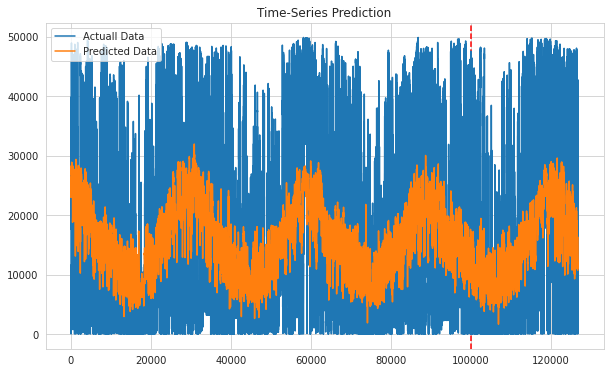

In [ ]:
train_predict = lstm1(df_X_ss)#forward pass
data_predict = train_predict.data.numpy() #numpy conversion
dataY_plot = df_y_mm #.data.numpy()

data_predict = mm.inverse_transform(data_predict) #reverse transformation
dataY_plot = mm.inverse_transform(dataY_plot)
plt.figure(figsize=(10,6)) #plotting
plt.axvline(x=100000, c='r', linestyle='--') #size of the training set

plt.plot(dataY_plot, label='Actuall Data') #actual plot
plt.plot(data_predict, label='Predicted Data') #predicted plot
plt.title('Time-Series Prediction')
plt.legend()
plt.show() 